<a href="https://colab.research.google.com/github/Untick/InspectrumClinic_HR_gr1/blob/main/Kiparenko%20Nikolai/INSPECTRUM_CLINIC_HR_RECSYS_GR1_AUTO_ML_04.07.2023.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Инициализация проекта

In [ ]:
!pip install h2o

import h2o

from h2o.automl import H2OAutoML
h2o.init()

!pip install autokeras
import autokeras as ak


In [ ]:

# Загрузка датасетов из облака
import gdown

# Функции операционной системы
import os

# Работа с массивами данных
import numpy as np

# Работа с таблицами
import pandas as pd

# автоматически парсит строку и сохранит ее в переменной datetime
import datetime

# Токенизатор для преобразование текстов в последовательности
from tensorflow.keras.preprocessing.text import Tokenizer

# Отрисовка графиков
import matplotlib.pyplot as plt
# Метрики для расчета ошибок
from sklearn.metrics import mean_squared_error, mean_absolute_error


In [ ]:
#Грузим файл
path = 'https://storage.yandexcloud.net/terratraineeship/23_InspectrumClinic_HR/datasets/%D0%94%D0%B0%D1%82%D0%B0%D0%A1%D0%B5%D1%82%20%D0%9E%D1%86%D0%B5%D0%BD%D0%BA%D0%B0%20%D1%80%D0%B5%D0%B7%D1%8E%D0%BC%D0%B5%20581%20%D1%80%D0%B5%D0%B7%D1%8E%D0%BC%D0%B5.xlsx'
path = "https://docs.google.com/spreadsheets/d/1tcfBgGY98cFx1DIvmoRy7goHXNcnaBZ7/export?format=xlsx"
gdown.download(path,'dataS.xlsx', quiet=True)



/usr/local/lib/python3.10/dist-packages/gdown/parse_url.py:35: UserWarning: You specified a Google Drive link that is not the correct link to download a file. You might want to try `--fuzzy` option or the following url: https://drive.google.com/uc?id=None
  warnings.warn(


'dataS.xlsx'

In [ ]:
#Читаем файл
data = pd.read_excel (r'dataS.xlsx', index_col=0)
data.to_csv('data.csv')
data.head(5)

,Дата отклика,"Пол, возраст",ЗП,Ищет работу на должность,Город,Занятость,График,Опыт (),Последнее/нынешное место работы,Последняя/нынешняя должность,Выполняемые задачи на прошлых местах работ,Обо мне,Ключевые навыки,Образование и ВУЗ,Обновление резюме,Подходит - да/нет
0,2023-02-23 00:00:00,Женщина,90 000 руб.,Growth Product Manager,"Индонезия, Не готова к переезду, не готова к к...","проектная работа, частичная занятость, полная ...",удаленная работа,Опыт работы —5 лет 10 месяцев,PT MYBALI APP GROUP,Менеджер по продукту,Маркетинговые исследования\nИсследование рынка...,NaN,Анализ рынка\nУправление проектами\nProduct Ma...,"Высшее, 2023, Нетоло́гия, 2014, Университет Ро...",23 февраля 2023 в 16:30,да
1,2023-01-11 00:00:00,Женщина,не указана,Growth Product Manager,"Москва, Готова к переезду, готова к командировкам",полная занятость,"удаленная работа, гибкий график, полный день",Опыт работы —11 лет 11 месяцев,Банк Открытие,Product owner трайб сбережения и инвестиции,Участие в команде роста\nВ2В\n\nЗадачи:\n- Раз...,NaN,Самомотивация\nТаймменеджмент\nКреативность\nЧ...,"Высшее, 2022, GeekBrains, 2010, Московский худ...",8 февраля 2023 в 09:15,да
2,2023-02-27 00:00:00,"Мужчина, 33 года, родился 23 августа 1989",150 000 руб.,Growth Product Manager,"Санкт-Петербург, Готов к переезду: Москва, гот...","проектная работа, частичная занятость, полная ...","удаленная работа, гибкий график, полный день",Опыт работы —7 лет 2 месяца,DIKIY LLC,,Запуск бренда и производства игристого кваса D...,"Чем бы я ни занимался с 2014 года, когда решил...",Продвижение бренда\nПланирование маркетинговых...,"Высшее, 2013, Санкт-Петербургский государствен...",28 февраля 2023 в 09:41,да
3,2023-01-11 00:00:00,"Мужчина, 32 года, родился 7 декабря 1990",не указана,Growth Product Manager,"Москва, м. Молодежная, Хочу переехать, готов к...","стажировка, частичная занятость, полная занятость","удаленная работа, гибкий график, полный день",Опыт работы —8 лет 10 месяцев,WeInvest,Product Manager (team leader),1. Исследование рынка\n2. Определение целевой ...,"Я проактивный, коммуникабельный, позитивный, д...",Управление проектами\nОрганизаторские навыки\n...,"Магистр, 2014, Московский государственный техн...",24 января 2023 в 12:07,да
4,2023-01-11 00:00:00,"Мужчина, 26 лет, родился 21 февраля 1996",150 000 руб.,Growth Product Manager,"Пермь, Хочу переехать, готов к командировкам","проектная работа, частичная занятость, полная ...","удаленная работа, гибкий график, полный день",Опыт работы —5 лет 9 месяцев,Индивидуальное предпринимательство / частная п...,Product/Project manager,Переговоры со стейкхолдером\n- Составление ТЗ...,Набрал кучу опыта и хочу с ним найти классную ...,Управление персоналом\nЗаключение договоров\nА...,"Высшее, 2021, Российская академия народного хо...",6 февраля 2023 в 11:18,да


### Вспомогательные функции

In [ ]:
def convertDataSet(data):
         #Если необходимо переименовать
          data.columns = ['Response_date', 'Gender', 'Salary', 'Job', 'City', 'Employment', 'Schedule', 'Experience', 'Last_place', 'Position', 'Tasks', 'AboutMe', 'Skills', 'Education',  'Update_resume', 'Suitable']

          data = data.loc[(data['Job'] == 'HR-специалист') | (data['Job'] == 'Growth Product Manager')]

          dataDA = data.loc[(data['Suitable'] == 'да')]
          dataDA = data.iloc[:40]

          dataNA = data.loc[(data['Suitable'] == 'нет')]
          dataNA = data.iloc[:40]

          data = pd.merge(dataDA,dataNA)
          data = data.sample(frac=1)

          #Разбираем Дату раждения
          Birth = data['Gender'].apply(lambda x: x.split(',')[2].strip() if len(x.split(','))>2 else '')
          data = data.assign(Birth=Birth)
          #Разбираем Возраст
          Age = data['Gender'].apply(lambda x: x.split(',')[1].strip() if len(x.split(','))>1 else '')
          data = data.assign(Age=Age)

          #Тип образования
          DegreeOfStudy = data['Education'].apply(lambda x: x.split(',')[0].strip() if len(x.split(','))>1 else '')
          data = data.assign(DegreeOfStudy=DegreeOfStudy)
          #Год окончания образования
          YearOfGraduation = data['Education'].apply(lambda x: x.split(',')[1].strip() if len(x.split(','))>1 else '')
          data = data.assign(YearOfGraduation=YearOfGraduation)

          #Формируем список месяцев
          month_name = {1: 'января', 2: 'февраля', 3: 'марта', 4: 'апреля', 5: 'мая', 6: 'июня',
                7: 'июля', 8: 'августа', 9: 'сентября', 10: 'октября', 11: 'ноября', 12: 'декабря'}


          for i, row in data.iterrows():
            #Gender
            row.Gender = row.Gender.split(',')[0].strip()
            #Женщина = 0, Мужчина = 1
            row.Gender = row.Gender.replace('Женщина','0')
            row.Gender = row.Gender.replace('Мужчина','1')
            row.Gender = int(row.Gender)

            #Birth
            row.Birth = row.Birth.replace('родился','')
            row.Birth = row.Birth.replace('родилась','')

            #Age
            row.Age = row.Age.replace('года','')
            row.Age = row.Age.replace('год','')
            row.Age = row.Age.replace('лет','')
            row.Age = row.Age='' if 0 else row.Age

            try:
              row.Age = int(row.Age)
            except (IndexError, TypeError, ValueError):
              print(row.Age)
              row.Age = 0

            try:
                row.YearOfGraduation = int(row.YearOfGraduation)
            except (IndexError, TypeError, ValueError):
                print(row.YearOfGraduation)
                row.YearOfGraduation = 0

            #Salary
            row.Salary = row.Salary.replace(' ','')
            row.Salary = str(float(row.Salary.replace('KGS',''))*0.90)      if row.Salary.find('KGS') != -1 else row.Salary
            row.Salary = str(float(row.Salary.replace('KZT',''))*0.20)      if row.Salary.find('KZT') != -1 else row.Salary
            row.Salary = str(float(row.Salary.replace('USD',''))*80.00)     if row.Salary.find('USD') != -1 else row.Salary
            row.Salary = str(float(row.Salary.replace('EUR',''))*85.00)     if row.Salary.find('EUR') != -1 else row.Salary
            row.Salary = row.Salary.replace('руб.','')
            row.Salary = row.Salary.replace('руб','')
            row.Salary = row.Salary.replace('неуказана','0')
            row.Salary = int(float(row.Salary))

            #Experience
            row.Experience = row.Experience.replace('Опыт работы —','')
            row.Experience = row.Experience.replace('Опыт работы','')
            row.Experience = row.Experience.replace('года',';')
            row.Experience = row.Experience.replace('лет',';')
            row.Experience = row.Experience.replace('годов',';')
            row.Experience = row.Experience.replace('год',';')
            row.Experience = row.Experience.replace('года',';')
            row.Experience = row.Experience.replace('месяцев','')
            row.Experience = row.Experience.replace('месяца','')
            row.Experience = row.Experience.replace('месяц','')
            row.Experience = row.Experience.replace('нет','0')
            #Приводим к месяцам, если были года умножаем на 12 иначе берем как есть
            row.Experience = (int(row.Experience.split(';')[0].strip()) * 12 + (int(row.Experience.split(';')[1].strip())) if row.Experience.split(';')[1].strip() != '' else int(row.Experience.split(';')[0].strip()) * 12) if len(row.Experience.split(';')) >1 else int(row.Experience.strip())

            #Schedule
            #вахтовый метод = 0, удаленная работа = 1, гибкий график = 2, полный день = 3, сменный график = 4
            row.Schedule = row.Schedule.replace('вахтовый метод','0')
            row.Schedule = row.Schedule.replace('удаленная работа','1')
            row.Schedule = row.Schedule.replace('гибкий график','2')
            row.Schedule = row.Schedule.replace('полный день','3')
            row.Schedule = row.Schedule.replace('сменный график','4')

            #Employment
            #проектная работа = 0, неполный рабочий день = 1, полный рабочий день = 2, полная занятость = 3, частичная занятость = 4, стажировка = 5, волонтерство = 6
            row.Employment = row.Employment.replace('проектная работа','0')
            row.Employment = row.Employment.replace('неполный рабочий день','1')
            row.Employment = row.Employment.replace('полный рабочий день','2')
            row.Employment = row.Employment.replace('полная занятость','3')
            row.Employment = row.Employment.replace('частичная занятость','4')
            row.Employment = row.Employment.replace('стажировка','5')
            row.Employment = row.Employment.replace('волонтерство','6')

            #Birth
            for i in month_name:
              row.Birth         = row.Birth.replace(month_name[i],'-'+str(i)+'-')

            row.Birth         = row.Birth.replace('родился','')
            row.Birth         = row.Birth.replace('родилась','')
            row.Birth         = row.Birth.replace(' -','-')
            row.Birth         = row.Birth.replace('- ','-')
            row.Birth         = row.Birth+' 00:00:00'

            row.Birth = '1-1-1' +row.Birth if row.Birth == ' 00:00:00' else row.Birth
            day = int(row.Birth.split('-')[0].strip())
            month = int(row.Birth.split('-')[1].strip())
            year = row.Birth.split('-')[2].strip()
            time = year.split(' ')[1].strip()
            year = int(year.split(' ')[0].strip())

            row.Birth = int(datetime.datetime(year,month,day).utcnow().timestamp())

            #Update_resume

            '''
            for i in month_name:
              row.Update_resume = row.Update_resume.replace(month_name[i],'-'+str(i)+'-')

            row.Update_resume = row.Update_resume.replace('в','')
            row.Update_resume = row.Update_resume.replace(' -','-')
            row.Update_resume = row.Update_resume.replace('- ','-')
            row.Update_resume = row.Update_resume+':00'

            day = int(row.Update_resume.split('-')[0].strip())
            month = int(row.Update_resume.split('-')[1].strip())
            year = row.Update_resume.split('-')[2].strip()
            year = year.replace('  ',';')
            year = year.replace(' ',';')

            time = year.split(';')[1].strip()
            year = int(year.split(';')[0].strip())
            hour = int(time.split(':')[0].strip())
            minute = int(time.split(':')[1].strip())

            row.Update_resume = int(datetime.datetime(year,month,day,hour,minute,0).utcnow().timestamp())

            #Response_date
            row.Response_date = int(datetime.datetime.utcnow().timestamp())
            '''

          #Переведем в бинарные значения

          #проектная работа = 0, неполный рабочий день = 1, полный рабочий день = 2, полная занятость = 3, частичная занятость = 4, стажировка = 5, волонтерство = 6
          Employment_0 = data['Employment'].apply(lambda x: 1 if x.find('0') else 0)
          Employment_1 = data['Employment'].apply(lambda x: 1 if x.find('1') else 0)
          Employment_2 = data['Employment'].apply(lambda x: 1 if x.find('2') else 0)
          Employment_3 = data['Employment'].apply(lambda x: 1 if x.find('3') else 0)
          Employment_4 = data['Employment'].apply(lambda x: 1 if x.find('4') else 0)
          Employment_5 = data['Employment'].apply(lambda x: 1 if x.find('5') else 0)
          Employment_6 = data['Employment'].apply(lambda x: 1 if x.find('6') else 0)

          data = data.assign(Employment_0=Employment_0,
                              Employment_1=Employment_1,
                              Employment_2=Employment_2,
                              Employment_3=Employment_3,
                              Employment_4=Employment_4,
                              Employment_5=Employment_5,
                              Employment_6=Employment_6)

          #вахтовый метод = 0, удаленная работа = 1, гибкий график = 2, полный день = 3, сменный график = 4
          Schedule_0 = data['Schedule'].apply(lambda x: 1 if x.find('0') else 0)
          Schedule_1 = data['Schedule'].apply(lambda x: 1 if x.find('1') else 0)
          Schedule_2 = data['Schedule'].apply(lambda x: 1 if x.find('2') else 0)
          Schedule_3 = data['Schedule'].apply(lambda x: 1 if x.find('3') else 0)
          Schedule_4 = data['Schedule'].apply(lambda x: 1 if x.find('4') else 0)

          data = data.assign(Schedule_0=Schedule_0,
                              Schedule_1=Schedule_1,
                              Schedule_2=Schedule_2,
                              Schedule_3=Schedule_3,
                              Schedule_4=Schedule_4)

          data = data.drop(columns=['Schedule', 'Employment'])


          #City
          tokenizer = Tokenizer(num_words=30, filters='!"#$%&()*+,-–—./…:;<=>?@[\\]^_`{|}~«»\t\n\xa0\ufeff', lower=True, split=' ', oov_token='неизвестное_слово', char_level=False)
          tokenizer.fit_on_texts(data.City) #"скармливаем" наши тексты, т.е даём в обработку методу, который соберет словарь частотности

          City_Indexes = tokenizer.texts_to_sequences(data.City)
          data = data.assign(City=City_Indexes)

          #Full_name
          #tokenizer = Tokenizer(num_words=100, filters='!"#$%&()*+,-–—./…:;<=>?@[\\]^_`{|}~«»\t\n\xa0\ufeff', lower=True, split=' ', oov_token='неизвестное_слово', char_level=False)
          #tokenizer.fit_on_texts(data.Full_name)

          #Full_name_Indexes = tokenizer.texts_to_sequences(data.Full_name)
          #data = data.assign(Full_name=Full_name_Indexes)

          #Education
          tokenizer = Tokenizer(num_words=200, filters='!"#$%&()*+,-–—./…:;<=>?@[\\]^_`{|}~«»\t\n\xa0\ufeff', lower=True, split=' ', oov_token='неизвестное_слово', char_level=False)
          tokenizer.fit_on_texts(data.Education) #"скармливаем" наши тексты, т.е даём в обработку методу, который соберет словарь частотности

          Education_Indexes = tokenizer.texts_to_sequences(data.Education)
          data = data.assign(Education=Education_Indexes)

          #DegreeOfStudy
          tokenizer = Tokenizer(num_words=20, filters='!"#$%&()*+,-–—./…:;<=>?@[\\]^_`{|}~«»\t\n\xa0\ufeff', lower=True, split=' ', oov_token='неизвестное_слово', char_level=False)
          tokenizer.fit_on_texts(data.DegreeOfStudy) #"скармливаем" наши тексты, т.е даём в обработку методу, который соберет словарь частотности

          DegreeOfStudy_Indexes = tokenizer.texts_to_sequences(data.DegreeOfStudy)
          data = data.assign(DegreeOfStudy=DegreeOfStudy_Indexes)

          #Job
          tokenizer = Tokenizer(num_words=150, filters='!"#$%&()*+,-–—./…:;<=>?@[\\]^_`{|}~«»\t\n\xa0\ufeff', lower=True, split=' ', oov_token='неизвестное_слово', char_level=False)
          tokenizer.fit_on_texts(data.Job) #"скармливаем" наши тексты, т.е даём в обработку методу, который соберет словарь частотности

          Job_Indexes = tokenizer.texts_to_sequences(data.Job)
          data = data.assign(Job=Job_Indexes)

          #Last_place
          tokenizer = Tokenizer(num_words=150, filters='!"#$%&()*+,-–—./…:;<=>?@[\\]^_`{|}~«»\t\n\xa0\ufeff', lower=True, split=' ', oov_token='неизвестное_слово', char_level=False)
          tokenizer.fit_on_texts(data.Last_place) #"скармливаем" наши тексты, т.е даём в обработку методу, который соберет словарь частотности

          Last_place_Indexes = tokenizer.texts_to_sequences(data.Last_place)
          data = data.assign(Last_place=Last_place_Indexes)

          #Position
          tokenizer = Tokenizer(num_words=150, filters='!"#$%&()*+,-–—./…:;<=>?@[\\]^_`{|}~«»\t\n\xa0\ufeff', lower=True, split=' ', oov_token='неизвестное_слово', char_level=False)
          tokenizer.fit_on_texts(data.Position) #"скармливаем" наши тексты, т.е даём в обработку методу, который соберет словарь частотности

          Position_Indexes = tokenizer.texts_to_sequences(data.Position)
          data = data.assign(Position=Position_Indexes)

          #Tasks
          data['Tasks'] = data['Tasks'].replace(np.nan, '')
          tokenizer = Tokenizer(num_words=1000, filters='1-9NaN!"#$%&()*+,-–—./…:;<=>?@[\\]^_`{|}~«»\t\n\xa0\ufeff', lower=True, split=' ', oov_token='неизвестное_слово', char_level=False)
          tokenizer.fit_on_texts(data.Tasks) #"скармливаем" наши тексты, т.е даём в обработку методу, который соберет словарь частотности

          Tasks_Indexes = tokenizer.texts_to_sequences(data.Tasks)
          data = data.assign(Tasks=Tasks_Indexes)

          #AboutMe
          data['AboutMe'] = data['AboutMe'].replace(np.nan, '')
          tokenizer = Tokenizer(num_words=1000, filters='0-9!"#$%&()*+,-–—./…:;<=>?@[\\]^_`{|}~«»\t\n\xa0\ufeff', lower=True, split=' ', oov_token='неизвестное_слово', char_level=False)
          tokenizer.fit_on_texts(data.AboutMe) #"скармливаем" наши тексты, т.е даём в обработку методу, который соберет словарь частотности
          AboutMe_Indexes = tokenizer.texts_to_sequences(data.AboutMe)
          data = data.assign(AboutMe=AboutMe_Indexes)

          #Skills
          data['Skills'] = data['Skills'].replace(np.nan, '')
          tokenizer = Tokenizer(num_words=1000, filters='0-9NaN!"#$%&()*+,-–—./…:;<=>?@[\\]^_`{|}~«»\t\n\xa0\ufeff', lower=True, split=' ', oov_token='неизвестное_слово', char_level=False)
          tokenizer.fit_on_texts(data.Skills) #"скармливаем" наши тексты, т.е даём в обработку методу, который соберет словарь частотности
          Skills_Indexes = tokenizer.texts_to_sequences(data.Skills)
          data = data.assign(Skills=Skills_Indexes)


          #Приведим все списки к однообразию
          #data.Response_date = data.Response_date.astype('int')
          data.Gender = data.Gender.astype('int')
          data.Salary = data.Salary.astype('int')
          #data.Update_resume = data.Update_resume.astype('int')
          data.Birth = data.Birth.astype('int')
          data.Age = data.Age.astype('int')
          data.YearOfGraduation = data.YearOfGraduation.astype('int')

          #Находим максимальную длину
          #Full_nameMaxI = 0
          PositionMaxI = 0
          Last_placeMaxI = 0
          JobMaxI = 0
          EducationMaxI = 0
          CityMaxI = 0
          DegreeOfStudyMaxI = 0
          Tasks_nameMaxI = 0
          AboutMe_nameMaxI = 0
          Skills_nameMaxI = 0
          for i, row in data.iterrows():
              #Full_nameMaxI   = max(Full_nameMaxI,len(row.Full_name))
              PositionMaxI    = max(PositionMaxI,len(row.Position))
              Last_placeMaxI  = max(Last_placeMaxI,len(row.Last_place))
              JobMaxI         = max(JobMaxI,len(row.Job))
              EducationMaxI   = max(EducationMaxI,len(row.Education))
              CityMaxI        = max(CityMaxI,len(row.City))
              DegreeOfStudyMaxI        = max(DegreeOfStudyMaxI,len(row.DegreeOfStudy))
              Tasks_nameMaxI        = max(Tasks_nameMaxI,len(row.Tasks))
              AboutMe_nameMaxI        = max(AboutMe_nameMaxI,len(row.AboutMe))
              Skills_nameMaxI        = max(Skills_nameMaxI,len(row.Skills))


          #обрабатываем данные list
          dataList = []
          for i, row in data.iterrows():
                #row.Full_name     = np.array(row.Full_name+[0 for x in range(Full_nameMaxI-len(row.Full_name))])
                row.Position      = np.array(row.Position+[0 for x in range(PositionMaxI-len(row.Position))])
                row.Last_place    = np.array(row.Last_place+[0 for x in range(Last_placeMaxI-len(row.Last_place))])
                row.Job           = np.array(row.Job+[0 for x in range(JobMaxI-len(row.Job))])
                row.Education     = np.array(row.Education+[0 for x in range(EducationMaxI-len(row.Education))])
                row.City          = np.array(row.City+[0 for x in range(CityMaxI-len(row.City))])
                row.DegreeOfStudy          = np.array(row.DegreeOfStudy+[0 for x in range(DegreeOfStudyMaxI-len(row.DegreeOfStudy))])
                row.Tasks         = np.array(row.Tasks+[0 for x in range(Tasks_nameMaxI-len(row.Tasks))])
                row.AboutMe       = np.array(row.AboutMe+[0 for x in range(AboutMe_nameMaxI-len(row.AboutMe))])
                row.Skills        = np.array(row.Skills+[0 for x in range(Skills_nameMaxI-len(row.Skills))])

                #row_data = np.hstack(row)
                row_data = np.hstack([
                                      #row.Full_name,
                                      row.Position,
                                      row.Last_place,
                                      row.Job,
                                      row.Education,
                                      row.City,
                                      row.Tasks,
                                      row.AboutMe,
                                      row.Skills,
                                     # row.Response_date,
                                      row.Gender,
                                      row.Salary,
                                     # row.Update_resume,
                                      row.Birth,
                                      row.Age,
                                      row.YearOfGraduation,
                                      row.DegreeOfStudy,
                                      row.Employment_0,
                                      row.Employment_1,
                                      row.Employment_2,
                                      row.Employment_3,
                                      row.Employment_4,
                                      row.Employment_5,
                                      row.Employment_6,
                                      row.Schedule_0,
                                      row.Schedule_1,
                                      row.Schedule_2,
                                      row.Schedule_3,
                                      row.Schedule_4]
                                    )

                dataList.append(row_data)

          dataset = np.array(dataList) #, dtype=np.float

          return data


In [ ]:
def takeDataSet(data):

          #Находим максимальную длину
          #Full_nameMaxI = 0
          PositionMaxI = 0
          Last_placeMaxI = 0
          JobMaxI = 0
          EducationMaxI = 0
          CityMaxI = 0
          DegreeOfStudyMaxI = 0
          Tasks_nameMaxI = 0
          AboutMe_nameMaxI = 0
          Skills_nameMaxI = 0
          for i, row in data.iterrows():
              #Full_nameMaxI   = max(Full_nameMaxI,len(row.Full_name))
              PositionMaxI    = max(PositionMaxI,len(row.Position))
              Last_placeMaxI  = max(Last_placeMaxI,len(row.Last_place))
              JobMaxI         = max(JobMaxI,len(row.Job))
              EducationMaxI   = max(EducationMaxI,len(row.Education))
              CityMaxI        = max(CityMaxI,len(row.City))
              DegreeOfStudyMaxI        = max(DegreeOfStudyMaxI,len(row.DegreeOfStudy))
              Tasks_nameMaxI        = max(Tasks_nameMaxI,len(row.Tasks))
              AboutMe_nameMaxI        = max(AboutMe_nameMaxI,len(row.AboutMe))
              Skills_nameMaxI        = max(Skills_nameMaxI,len(row.Skills))


          #обрабатываем данные list
          dataList = []
          for i, row in data.iterrows():
                #row.Full_name     = np.array(row.Full_name+[0 for x in range(Full_nameMaxI-len(row.Full_name))])
                row.Position      = np.array(row.Position+[0 for x in range(PositionMaxI-len(row.Position))])
                row.Last_place    = np.array(row.Last_place+[0 for x in range(Last_placeMaxI-len(row.Last_place))])
                row.Job           = np.array(row.Job+[0 for x in range(JobMaxI-len(row.Job))])
                row.Education     = np.array(row.Education+[0 for x in range(EducationMaxI-len(row.Education))])
                row.City          = np.array(row.City+[0 for x in range(CityMaxI-len(row.City))])
                row.DegreeOfStudy          = np.array(row.DegreeOfStudy+[0 for x in range(DegreeOfStudyMaxI-len(row.DegreeOfStudy))])
                row.Tasks         = np.array(row.Tasks+[0 for x in range(Tasks_nameMaxI-len(row.Tasks))])
                row.AboutMe       = np.array(row.AboutMe+[0 for x in range(AboutMe_nameMaxI-len(row.AboutMe))])
                row.Skills        = np.array(row.Skills+[0 for x in range(Skills_nameMaxI-len(row.Skills))])

                #row_data = np.hstack(row)
                row_data = np.hstack([
                                      #row.Full_name,
                                      row.Position,
                                      row.Last_place,
                                      row.Job,
                                      row.Education,
                                      row.City,
                                      row.Tasks,
                                      row.AboutMe,
                                      row.Skills,
                                     # row.Response_date,
                                      row.Gender,
                                      row.Salary,
                                     # row.Update_resume,
                                      row.Birth,
                                      row.Age,
                                      row.YearOfGraduation,
                                      row.DegreeOfStudy,
                                      row.Employment_0,
                                      row.Employment_1,
                                      row.Employment_2,
                                      row.Employment_3,
                                      row.Employment_4,
                                      row.Employment_5,
                                      row.Employment_6,
                                      row.Schedule_0,
                                      row.Schedule_1,
                                      row.Schedule_2,
                                      row.Schedule_3,
                                      row.Schedule_4]
                                    )

                dataList.append(row_data)

          dataset = np.array(dataList) #, dtype=np.float

          return dataset


##      **H2O**



### Без предварительной обработки

In [ ]:
data = pd.read_excel (r'dataS.xlsx', index_col=0)

#data = data.loc[(data['Ищет работу на должность'] == 'HR-специалист') | (data['Ищет работу на должность'] == 'Growth Product Manager')]

#dataDA = data.loc[(data['Подходит - да/нет'] == 'да')]
#dataDA = data.iloc[:40]

#dataNA = data.loc[(data['Подходит - да/нет'] == 'нет')]
#dataNA = data.iloc[:40]
#data = pd.merge(dataDA,dataNA)
#data = data.sample(frac=1)

data.to_csv('data.csv')
df = h2o.import_file("data.csv",header =1)
df = df[:,1:]

df.describe ()


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


Rows:1030
Cols:16

,Дата отклика,"Пол, возраст",ЗП,Ищет работу на должность,Город,Занятость,График,Опыт (),Последнее/нынешное место работы,Последняя/нынешняя должность,Выполняемые задачи на прошлых местах работ,Обо мне,Ключевые навыки,Образование и ВУЗ,Обновление резюме,Подходит - да/нет
type,time,enum,enum,enum,enum,enum,enum,enum,enum,enum,string,enum,enum,enum,enum,enum
mins,44603000.0,,,,,,,,,,NaN,,,,,
mean,1672892871631.488,,,,,,,,,,NaN,,,,,
maxs,1679788800000.0,,,,,,,,,,NaN,,,,,
sigma,69730799683.12485,,,,,,,,,,NaN,,,,,
zeros,0,,,,,,,,,,0,,,,,
missing,452,340,383,397,410,422,427,429,432,436,465,574,488,442,443,523
0,2023-02-23 00:00:00,Женщина,90 000 руб.,Growth Product Manager,"Индонезия, Не готова к переезду, не готова к командировкам","проектная работа, частичная занятость, полная занятость",удаленная работа,Опыт работы —5 лет 10 месяцев,PT MYBALI APP GROUP,Менеджер по продукту,"Маркетинговые исследования Исследование рынка; Исследование конкурентов; Исследование потребителей; Планирование рекламы. Виды исследований: Опросы; Фокус-группы; Глубинные интервью; Эксперименты, полевые исследования. Задачи в рамках исследования потребителей: Анализ потребительских трендов; Анализ обратной связи от клиентов; Сегментация аудитории; Составление портрета целевой аудитории. Реклама у лидеров мнений Организация и контроль взаимодействия с лидерами мнений (селебрити, блогеры). Опыт организации коллабораций. SMM и комьюнити-менеджмент Планирование продвижения; Создание и контроль контента; Наполнение аккаунтов, сообществ; Модерирование и развитие аккаунтов, сообществ. Социальные сети: Telegram. Прямая реклама Разработка программ лояльности.Составление и тестирование гипотез. Анализ конкурентов. Изучение потребностей потребителя ( касдев, проведения интервью) CJM Работа с UX/UR Визуализация данных. Бизнесмодель. Токономика проекта. Работа с документами. До 2017 работала в сфере продаж премиального сегмента. Немецкие компаний с мировым именем Porsche, VanLaakc. Английский бренд MonSoon",,Анализ рынка Управление проектами Product Management Проведение презентаций Навыки продаж Декомпозици Вывод продукта на рынок Custbev,"Высшее, 2023, Нетоло́гия, 2014, Университет Российской академии образования, Москва",23 февраля 2023 в 16:30,да
1,2023-01-11 00:00:00,Женщина,не указана,Growth Product Manager,"Москва, Готова к переезду, готова к командировкам",полная занятость,"удаленная работа, гибкий график, полный день",Опыт работы —11 лет 11 месяцев,Банк Открытие,Product owner трайб сбережения и инвестиции,"Участие в команде роста В2В Задачи: - Развитие продукта - медосмотр сотрудников предприятий. - Проведение исследований JTBD - Генерация и последующая реализация гипотез growhacking - Презентация проектов - Планирование, делегирование, постановка и контроль задач - Развитие продукта - сайт - Лидирование продукта - мобильный банк - Генерация и последующая реализация новых фичей - Презентация проектов - Организация исследований - А/В тестирование - Планирование, делегирование, постановка и контроль задач - Руководство командой - Мотивация команды - Разработка собственного продукта - Анализ рынка конкурентов - Определение объема рынка продукта - Определение ключевой ценности продукта - Формирование видения продукта - Формирование бизнес-модели продукта - Планирование задач - Формирование гипотез - Расчёт unit-экономики - Проведение CustDev - Формирование Customer Journey Map - Формирование маркетинговых стратегий - Найм сотрудников - Организация маркетинга - Настраивание учебного процесса - Ассертивная коммуникация с абсолютно разными людьми - Презентация продукта и навыки продаж - Делегирование, постановка и контроль продаж - Вывод нового продукта на рынок - Выстраивание маркетинговых стратегий - Формирование корпоративного стиля компании - Анализ рынка конкурентов - Постановка и контроль задач - Эффективная коммуникация в многонациональной команде - Реализация проектов по четкому (и не очень) ТЗ в жестких временных рамках - Поиск и найм сотрудников - Эффективная к

In [ ]:
train, test, valid = df.split_frame ( ratios = [ .6 , .20 ])

y = "Подходит - да/нет"
x_train= train.columns
x_train.remove(y)
x_train.remove("Дата отклика")


In [ ]:
aml_1 = H2OAutoML(max_models = 10, seed = 1)
hist = aml_1.train(x = x_train, y = y, training_frame = train)

AutoML progress: |
13:44:59.597: _train param, Dropping bad and constant columns: [Выполняемые задачи на прошлых местах работ]
13:44:59.968: XGBoost_1_AutoML_1_20230625_134459 [XGBoost def_2] failed: water.exceptions.H2OModelBuilderIllegalArgumentException: Illegal argument(s) for XGBoost model: XGBoost_1_AutoML_1_20230625_134459_cv_1.  Details: ERRR on field: _response_column: Response contains missing values (NAs) - not supported by XGBoost.

13:44:59.991: _train param, Dropping bad and constant columns: [Выполняемые задачи на прошлых местах работ]

███████████████
13:46:38.226: _train param, Dropping bad and constant columns: [Выполняемые задачи на прошлых местах работ]


13:46:49.951: _train param, Dropping bad and constant columns: [Выполняемые задачи на прошлых местах работ]
13:46:49.982: XGBoost_2_AutoML_1_20230625_134459 [XGBoost def_1] failed: water.exceptions.H2OModelBuilderIllegalArgumentException: Illegal argument(s) for XGBoost model: XGBoost_2_AutoML_1_20230625_134459_cv_

In [ ]:
best_model_1 = aml_1.leader
lb = aml_1.leaderboard
lb.head()

model_id,mean_per_class_error,logloss,rmse,mse
StackedEnsemble_AllModels_1_AutoML_1_20230625_134459,0.444444,0.190182,0.191346,0.0366134
GBM_5_AutoML_1_20230625_134459,0.444444,0.299509,0.194327,0.037763
StackedEnsemble_BestOfFamily_1_AutoML_1_20230625_134459,0.444444,0.190182,0.191346,0.0366134
GBM_3_AutoML_1_20230625_134459,0.444444,0.305215,0.200054,0.0400216
GBM_4_AutoML_1_20230625_134459,0.444444,0.305141,0.196994,0.0388065
GBM_grid_1_AutoML_1_20230625_134459_model_1,0.444444,0.299759,0.194087,0.0376696
XRT_1_AutoML_1_20230625_134459,0.444444,1.18861,0.194717,0.0379148
DeepLearning_1_AutoML_1_20230625_134459,0.444444,0.243971,0.207546,0.0430752
GBM_1_AutoML_1_20230625_134459,0.444444,0.291372,0.196037,0.0384303
DRF_1_AutoML_1_20230625_134459,0.444444,0.927857,0.192625,0.0371045


# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,mean_per_class_error,logloss,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_1_AutoML_1_20230625_134459,0.333333,0.806873,0.201584,0.0406362,22858,0.268813,StackedEnsemble
GBM_5_AutoML_1_20230625_134459,0.333333,0.277109,0.204463,0.0418051,811,0.093147,GBM
StackedEnsemble_BestOfFamily_1_AutoML_1_20230625_134459,0.333333,0.806873,0.201584,0.0406362,61728,0.089953,StackedEnsemble
GBM_4_AutoML_1_20230625_134459,0.333333,0.28823,0.209061,0.0437063,1521,0.056994,GBM
GBM_grid_1_AutoML_1_20230625_134459_model_1,0.333333,0.262122,0.207234,0.0429461,1040,0.077306,GBM
XRT_1_AutoML_1_20230625_134459,0.333333,1.41674,0.203798,0.0415335,805,0.036309,DRF
DeepLearning_1_AutoML_1_20230625_134459,0.333333,0.261998,0.203343,0.0413482,3838,0.100998,DeepLearning
GBM_1_AutoML_1_20230625_134459,0.333333,0.266869,0.210975,0.0445106,1727,0.04984,GBM
DRF_1_AutoML_1_20230625_134459,0.333333,0.812706,0.191124,0.0365284,704,0.040579,DRF
GLM_1_AutoML_1_20230625_134459,0.333333,0.806873,0.201584,0.0406362,285,0.009286,GLM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_AllModels_1_AutoML_1_20230625_134459

госорганом.,госорганом.,да,к способам доставки – почту России,контент-планирование,нет,оптимизация налогообложения внешнеэкономической деятельности,организация диспетчеризации и обработки заявок с чат ботом на первой линии);,строительно-монтажные услуги,Error,Rate
0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1 / 1
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0,2 / 2
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,95.0,0.0,0.0,0.0,0.0,0 / 95
0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1 / 1
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,99.0,0.0,0.0,0.0,0.0404040,4 / 99


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:232: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


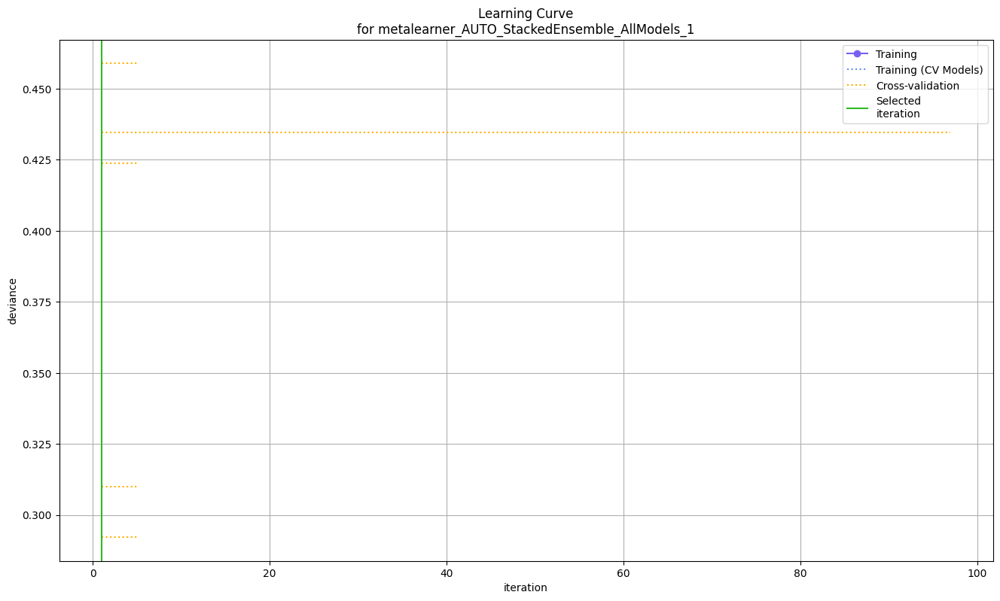

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

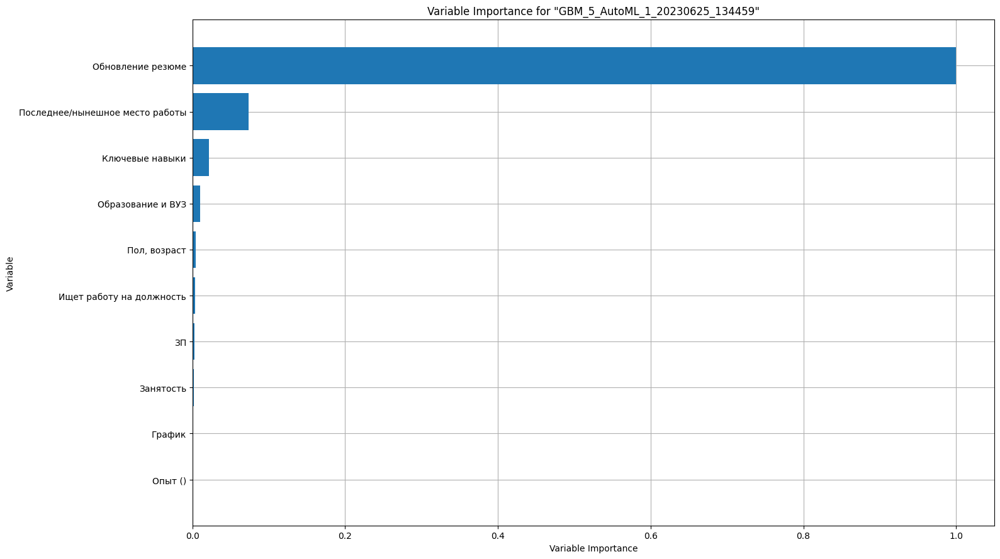

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

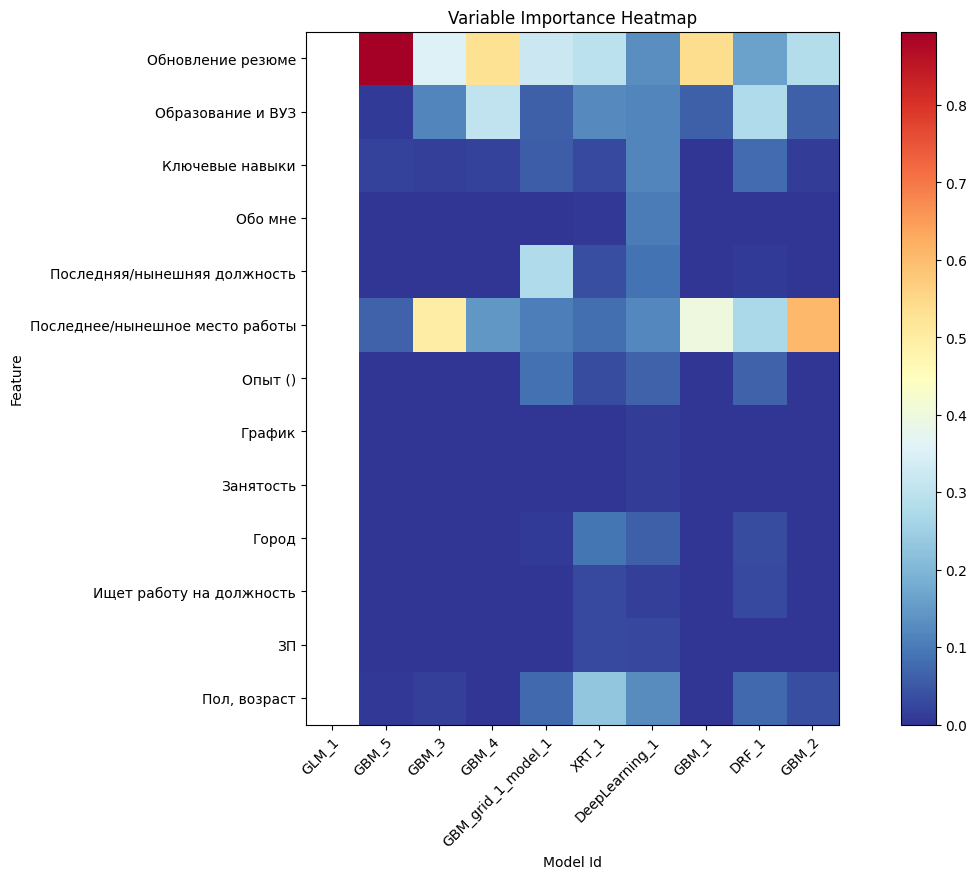

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

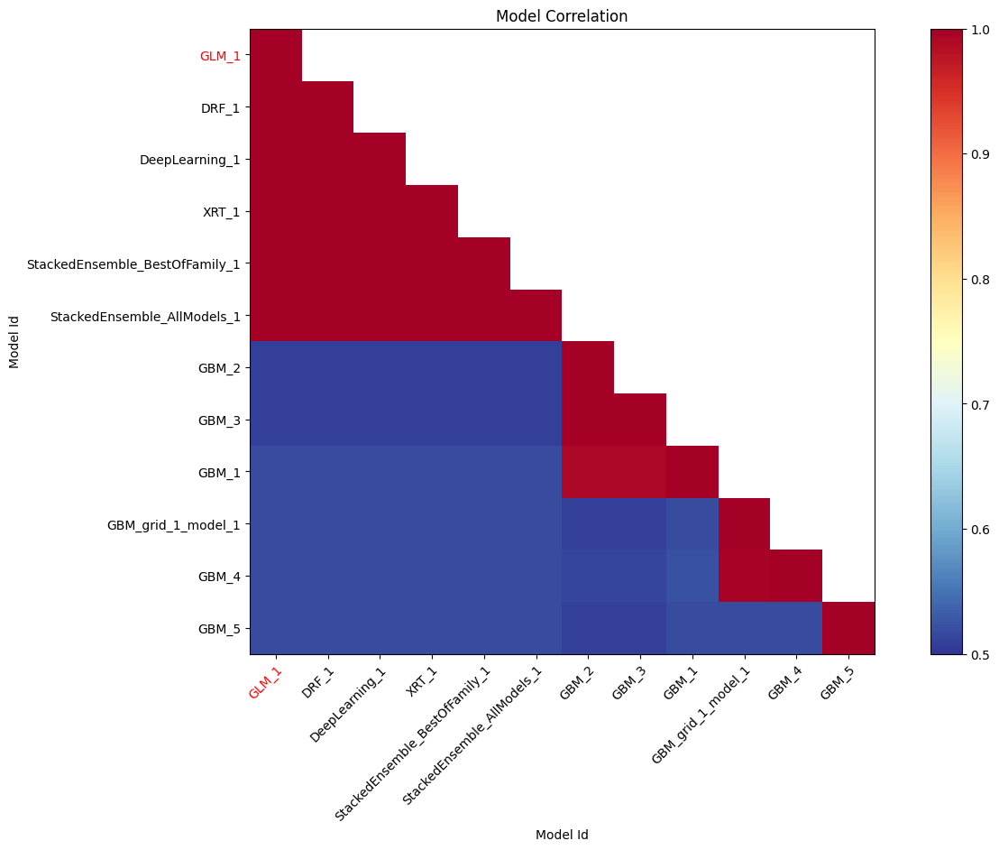

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

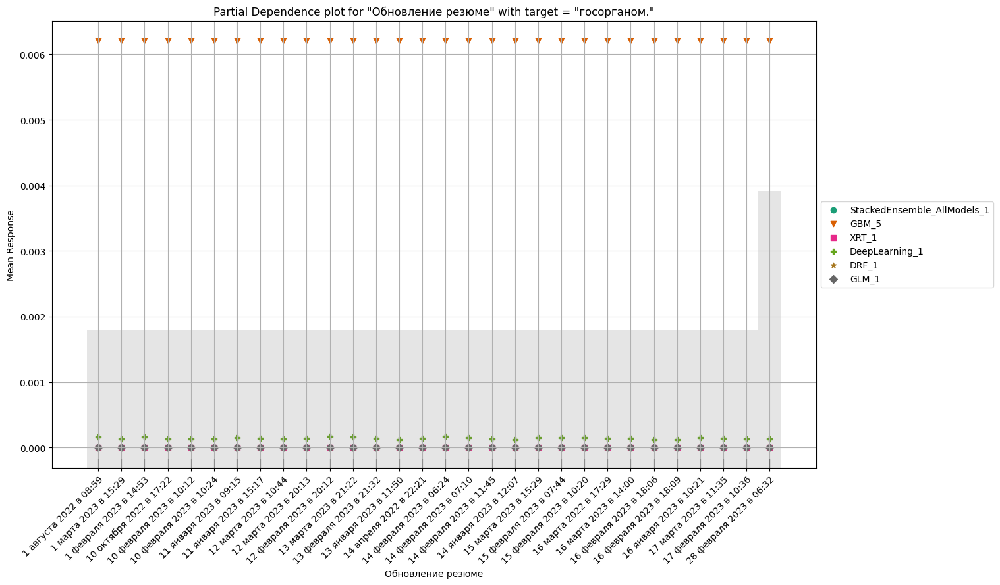

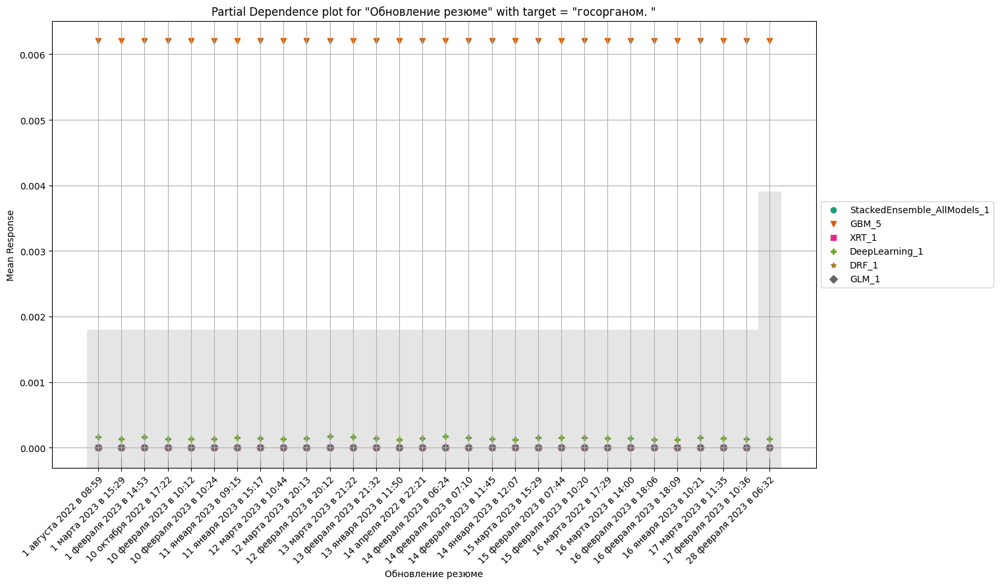

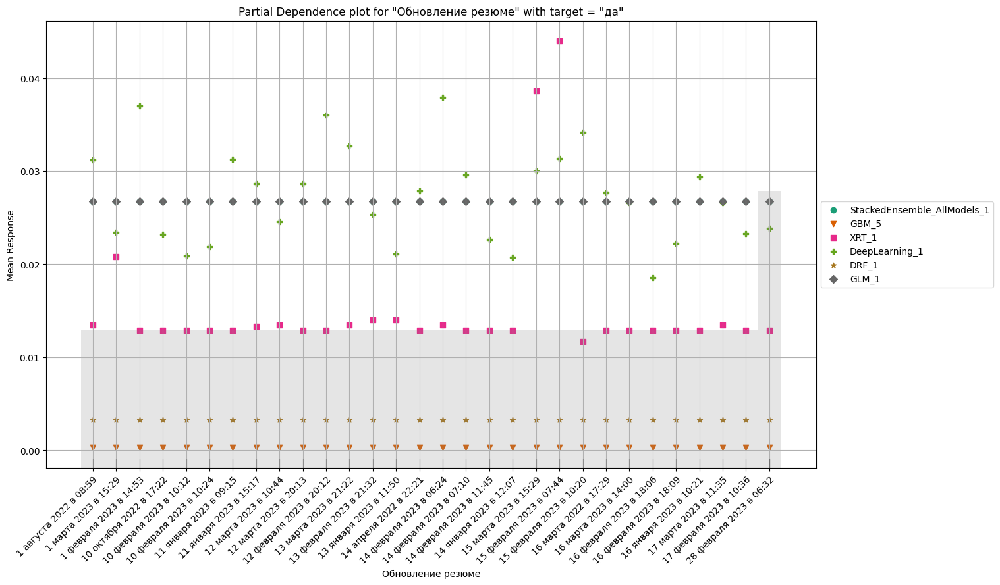

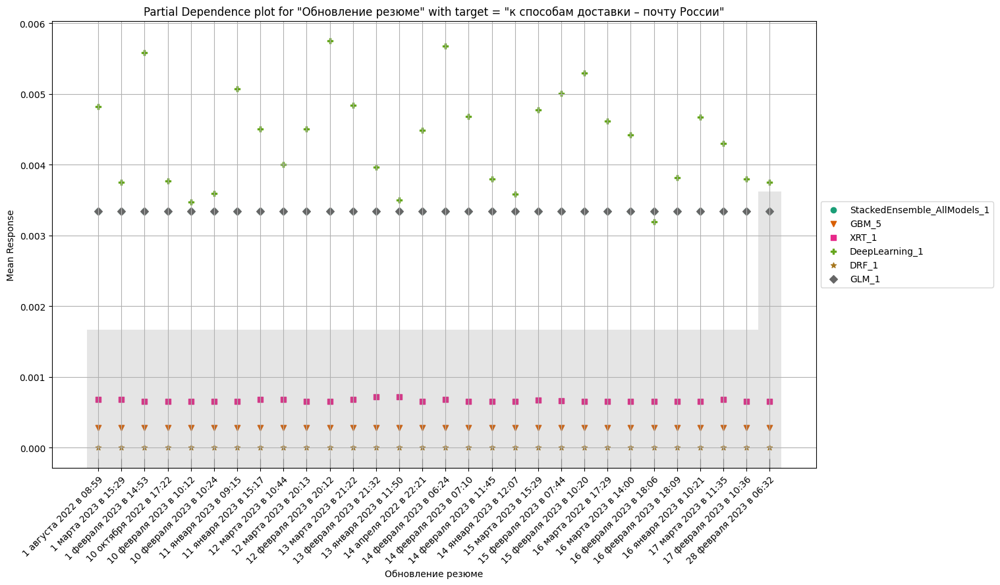

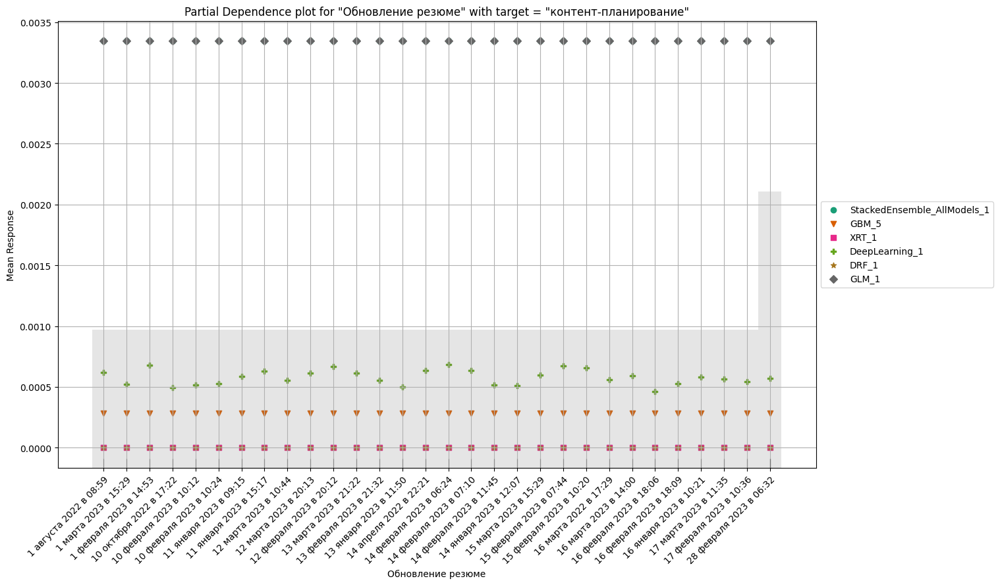

...

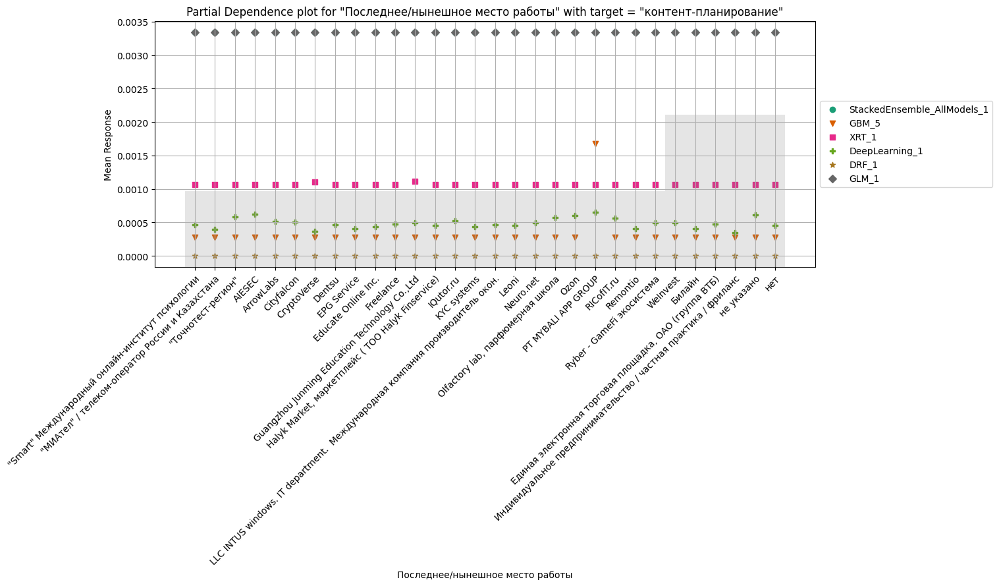

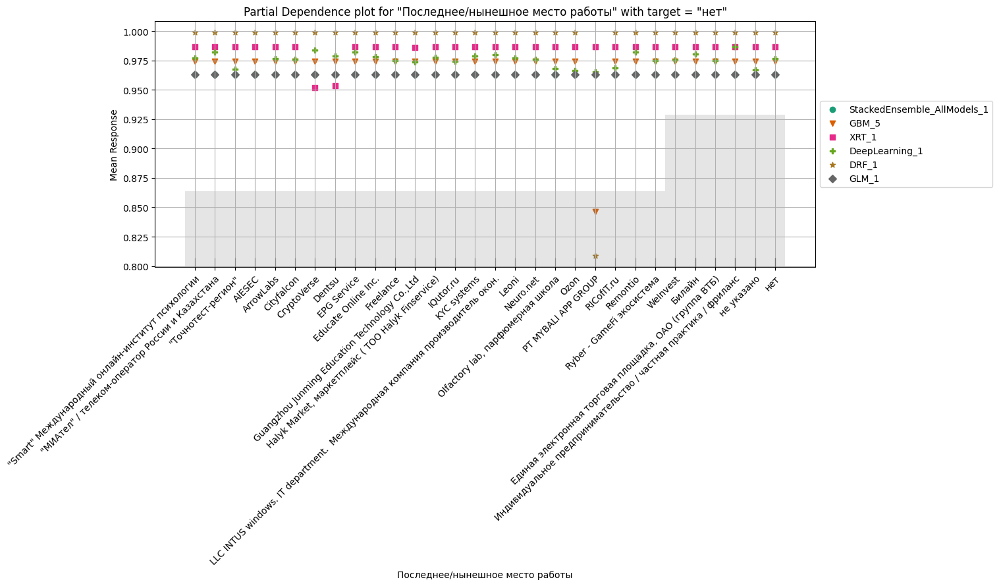

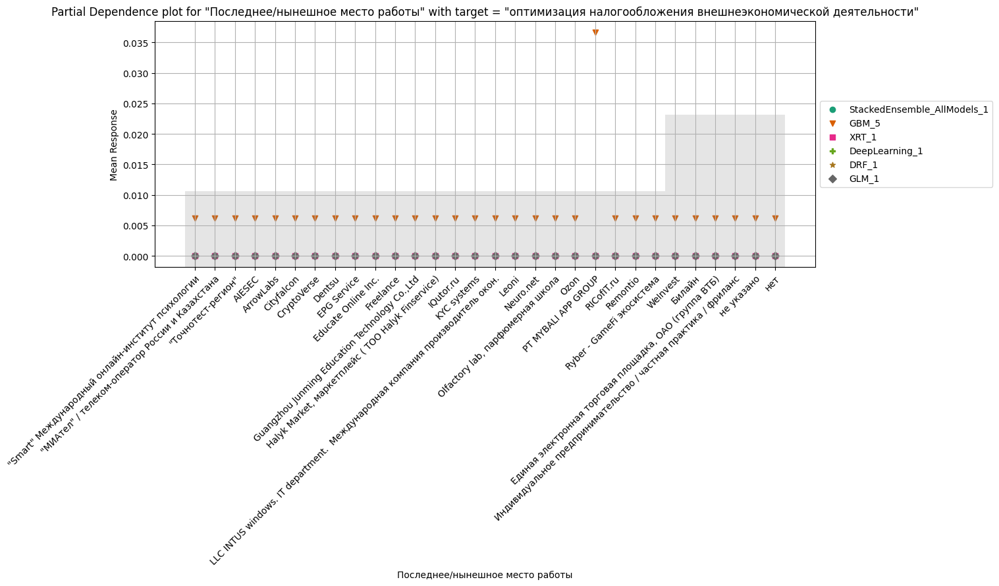

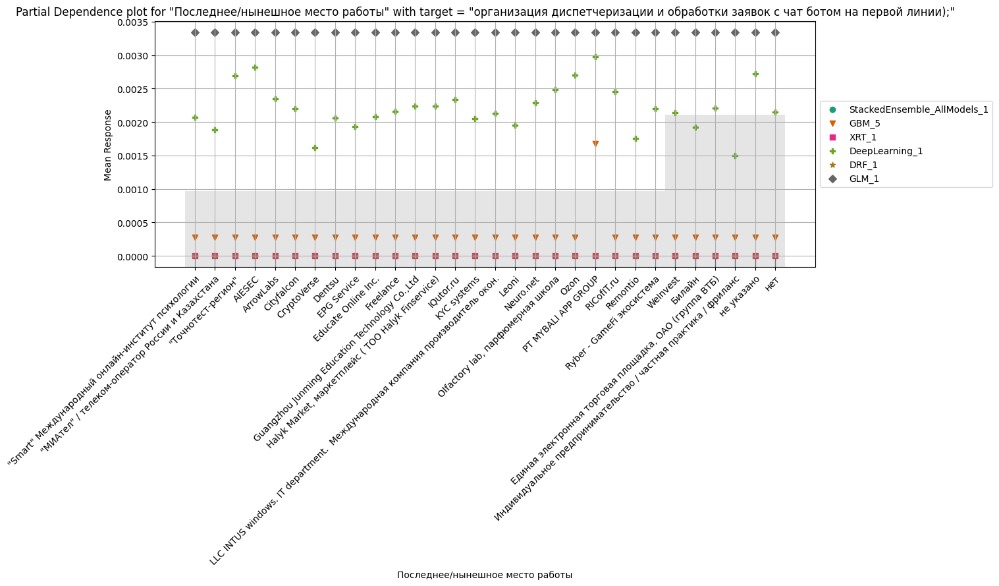

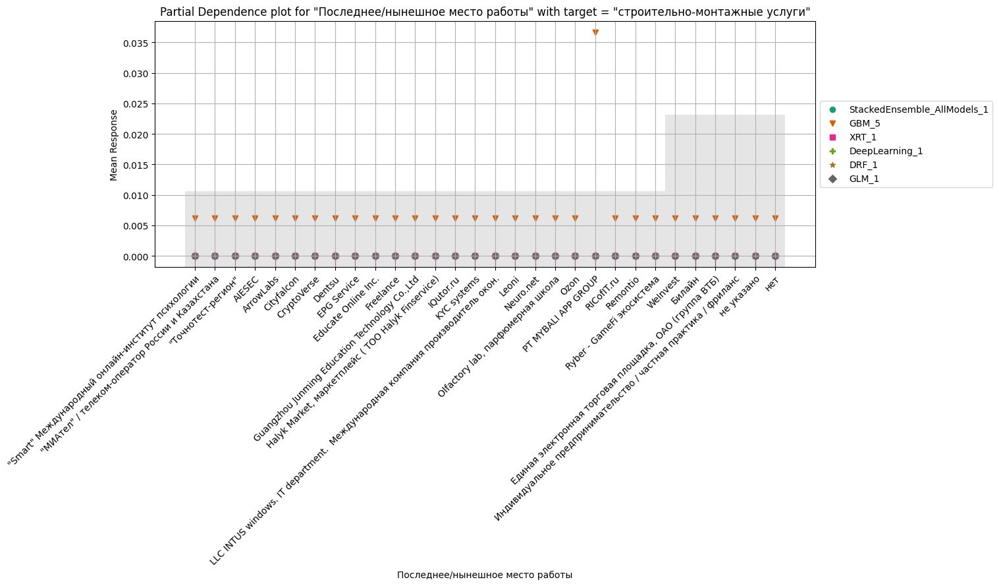

/usr/local/lib/python3.10/dist-packages/h2o/explanation/_explain.py:1618: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout(rect=[0, 0, 0.8, 1])


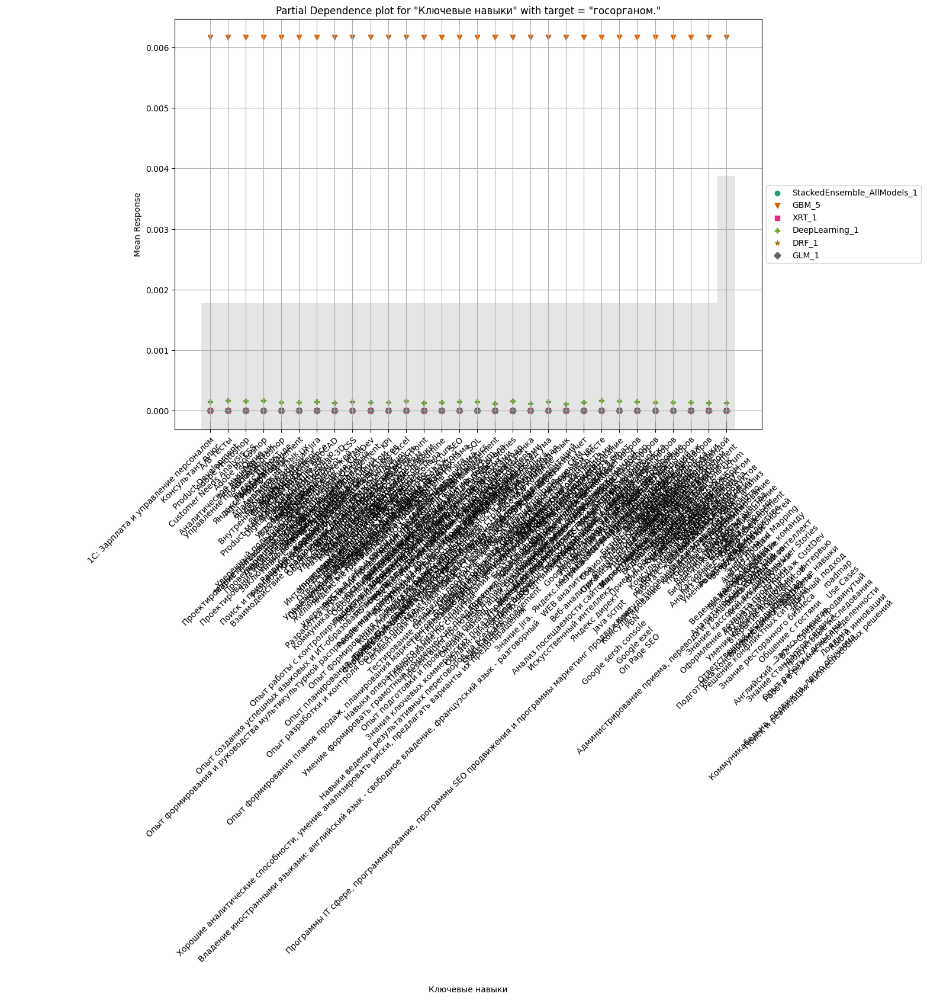

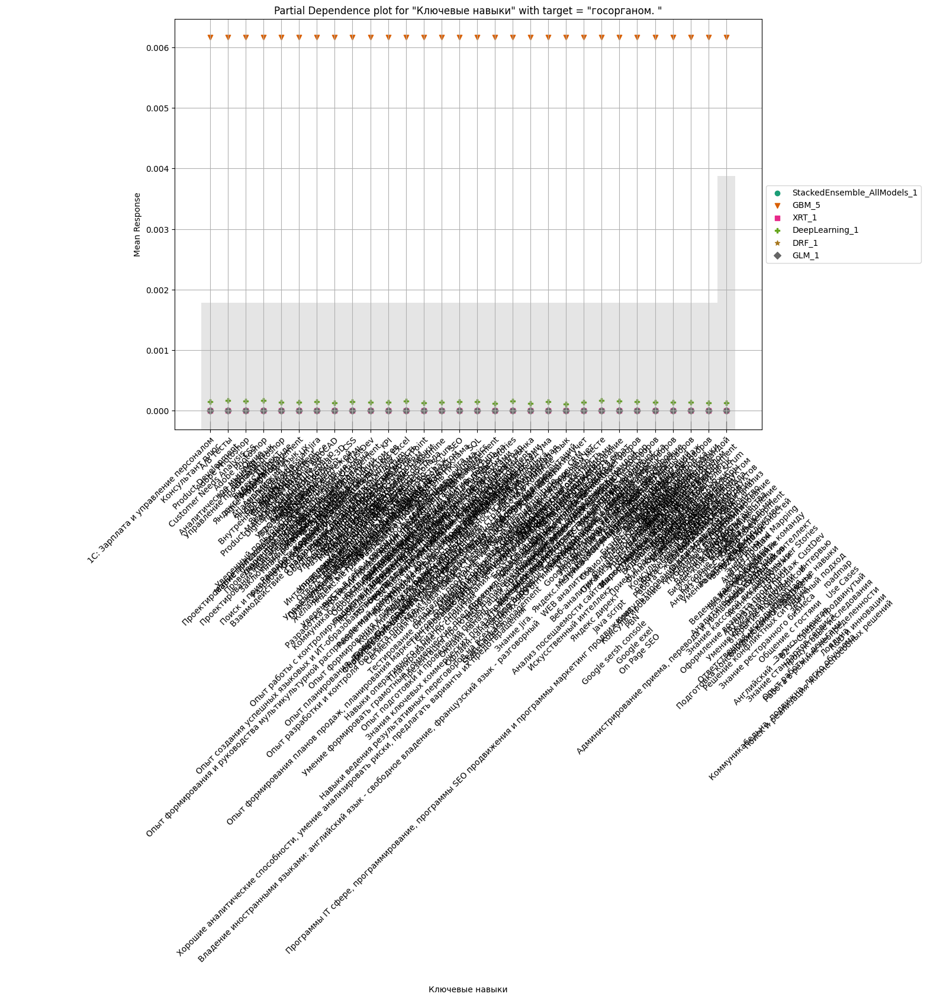

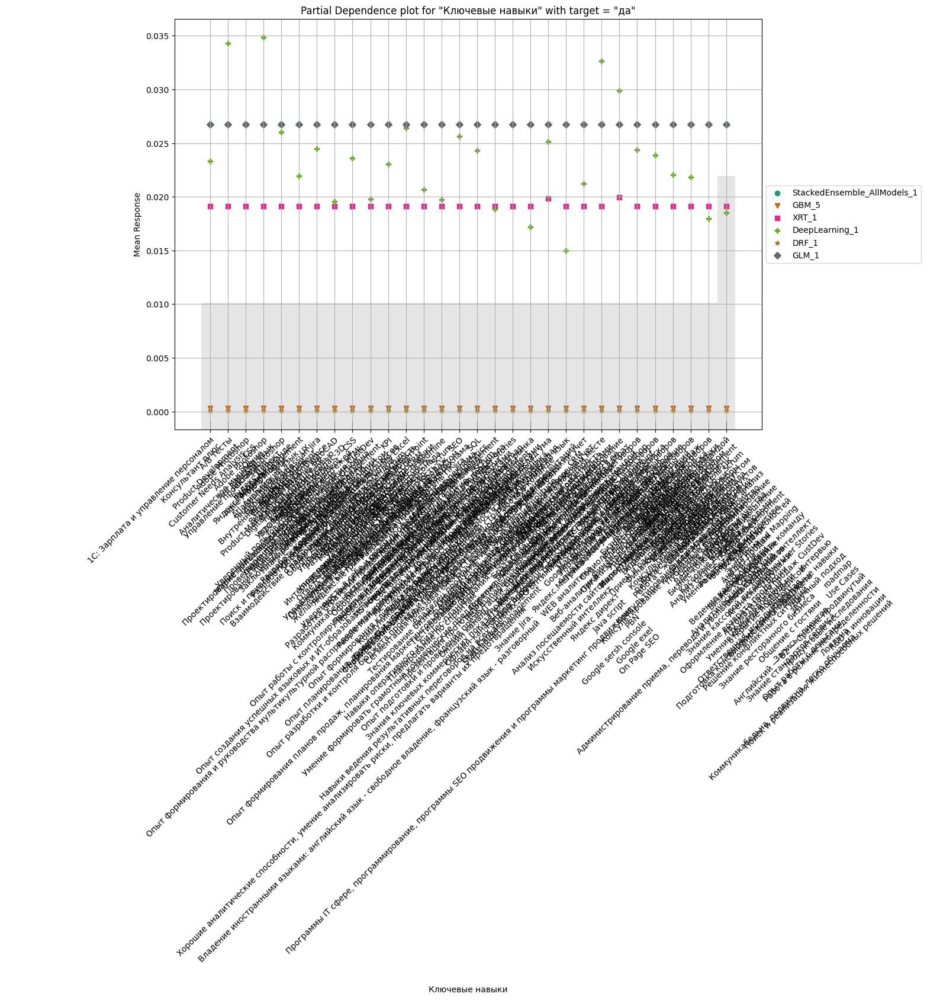

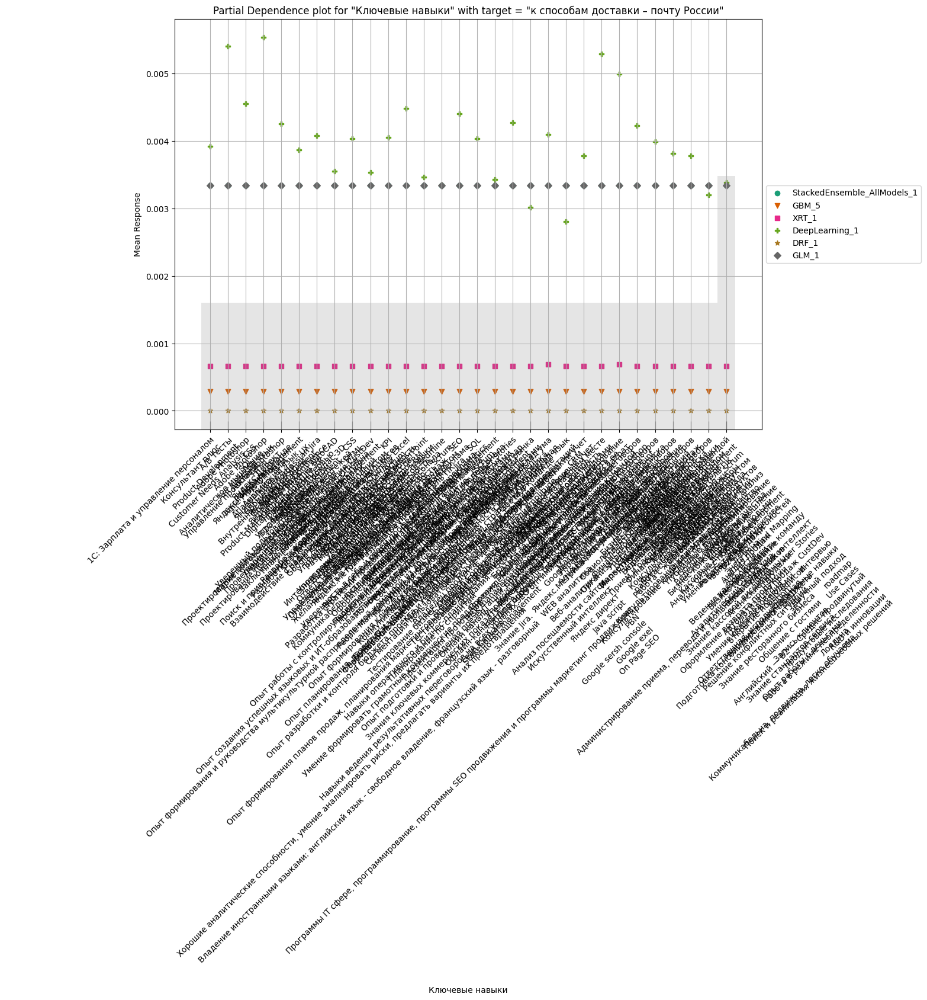

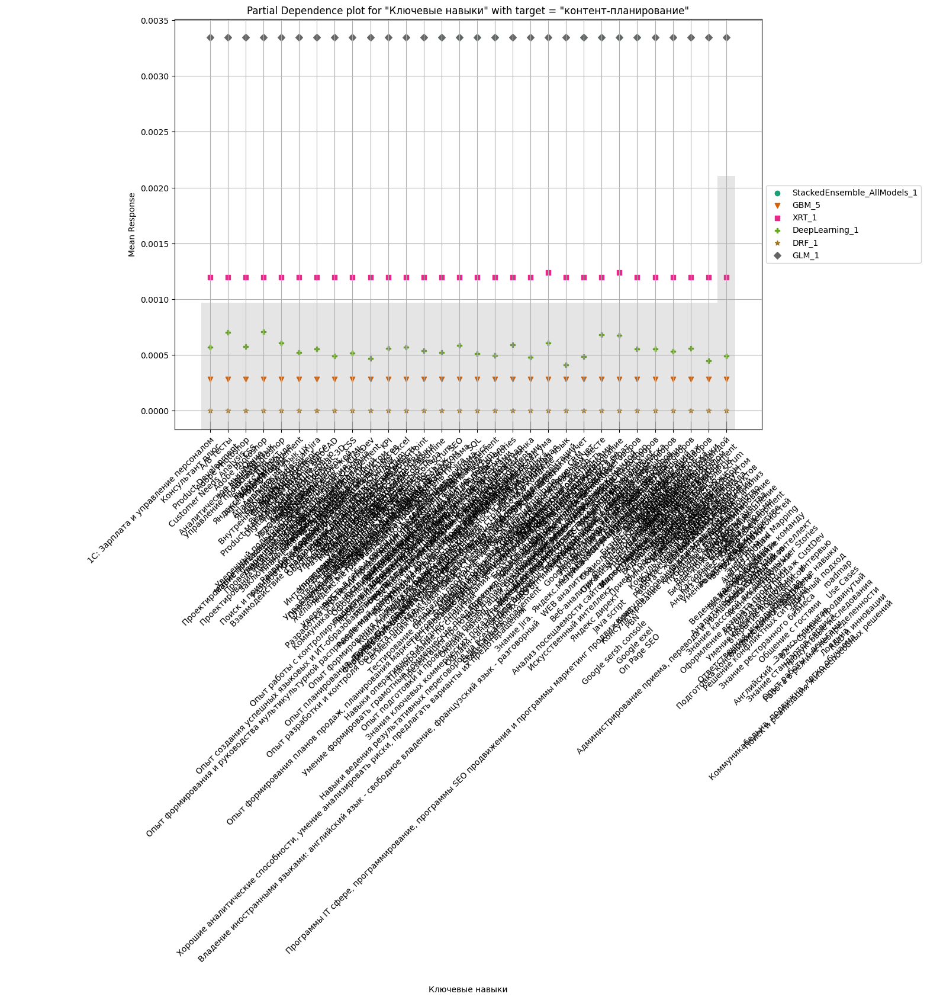

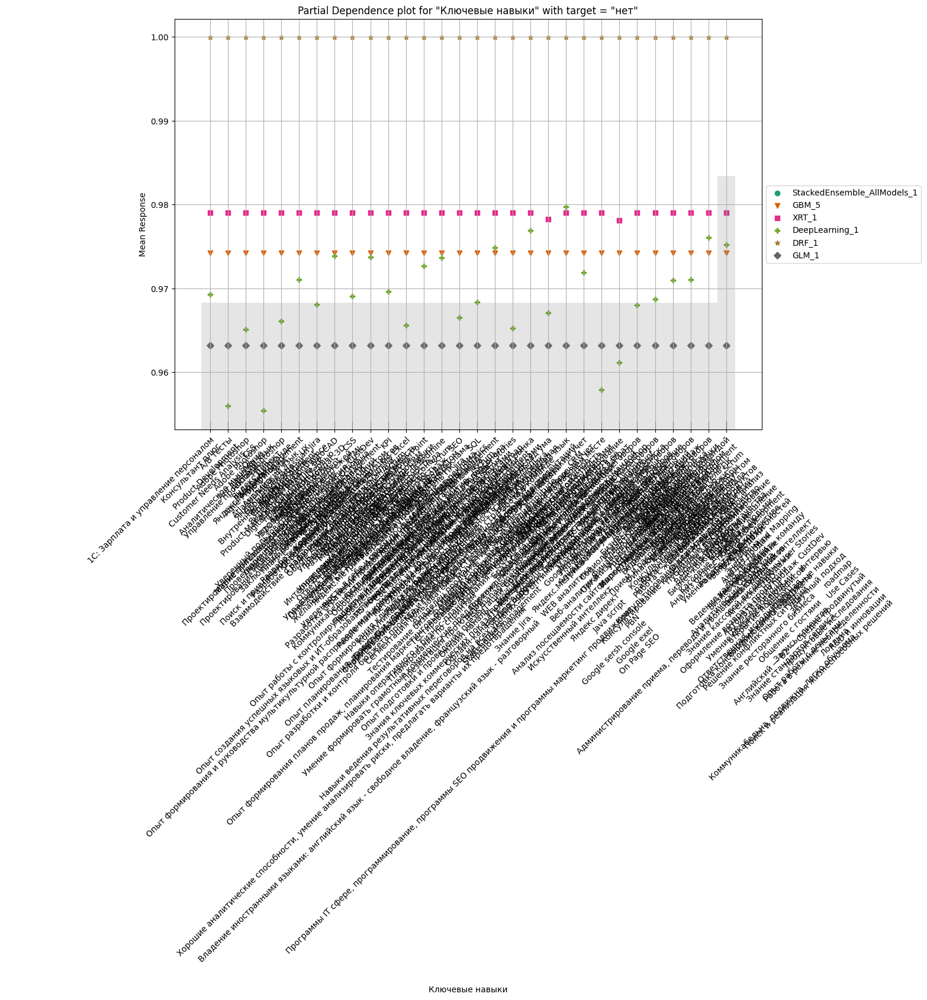

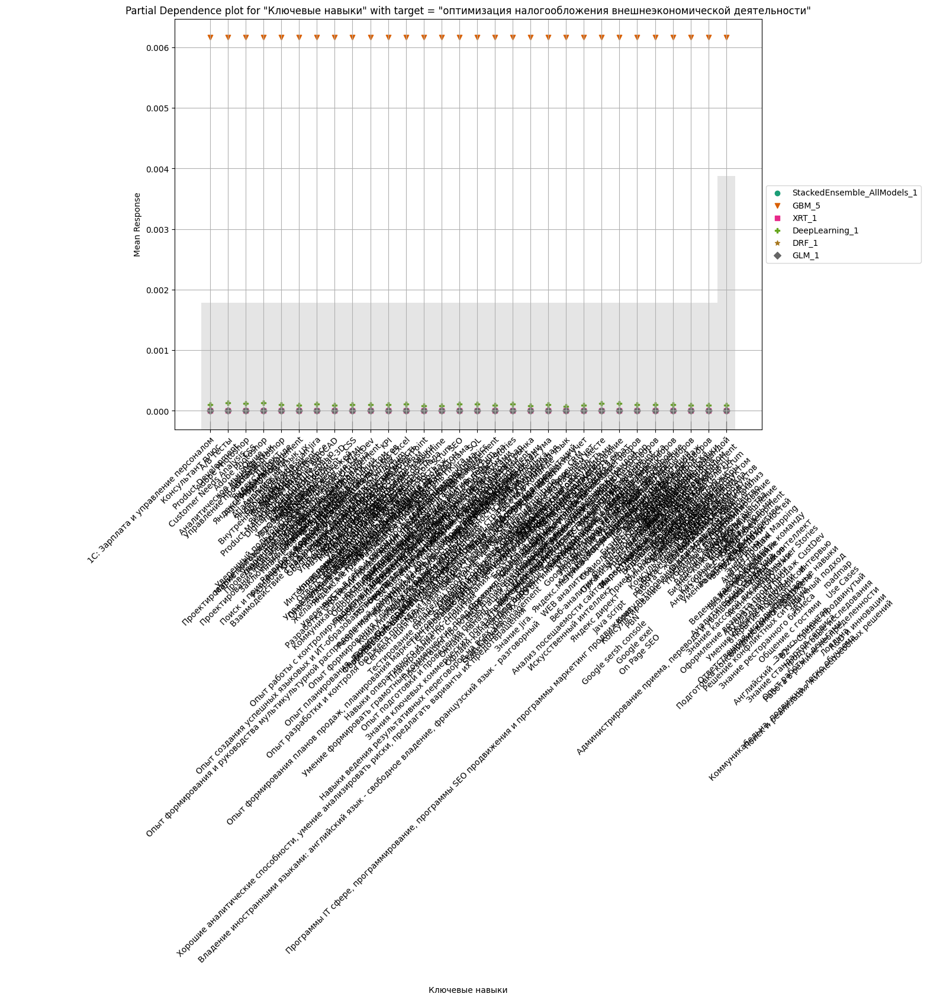

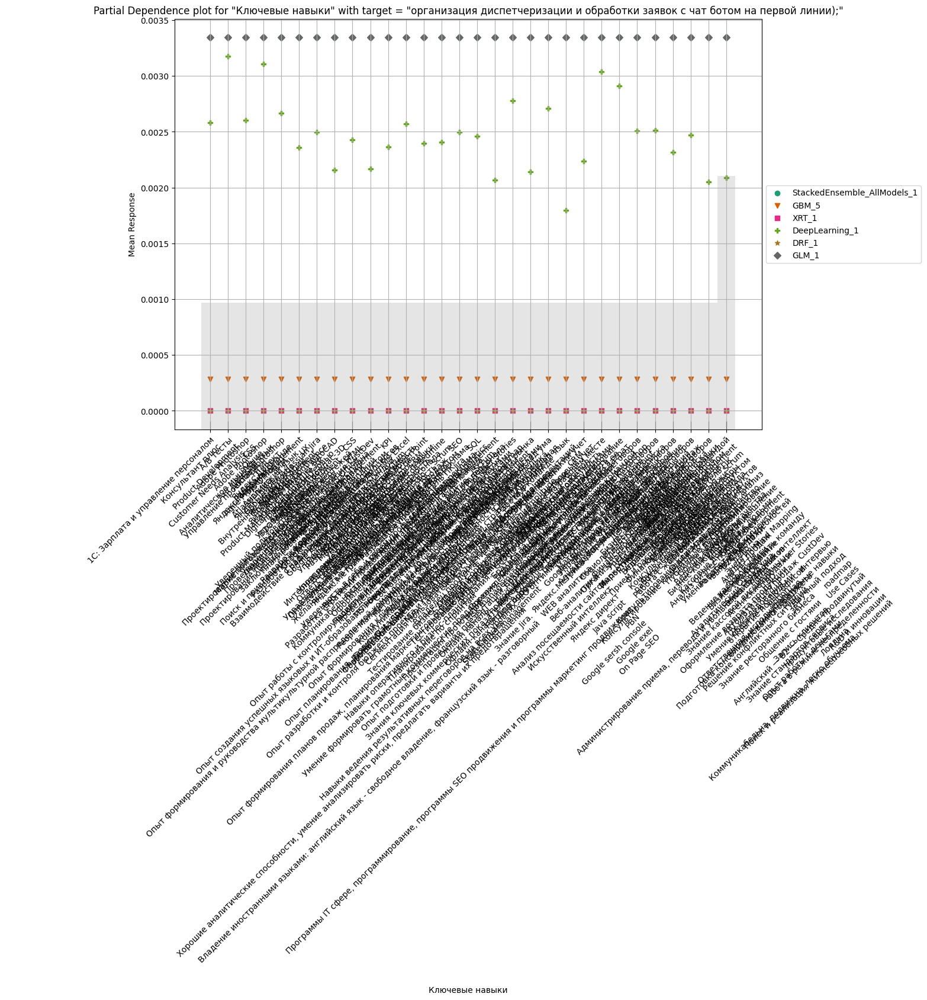

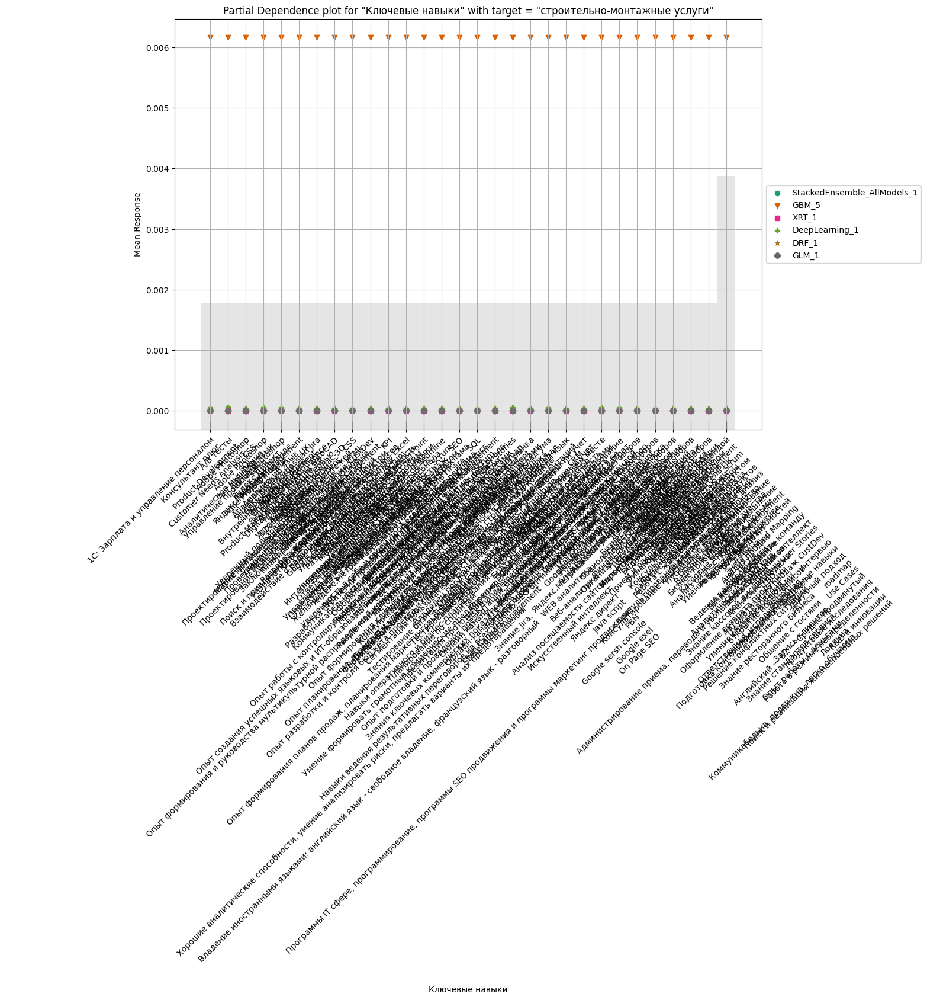

/usr/local/lib/python3.10/dist-packages/h2o/explanation/_explain.py:1618: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout(rect=[0, 0, 0.8, 1])


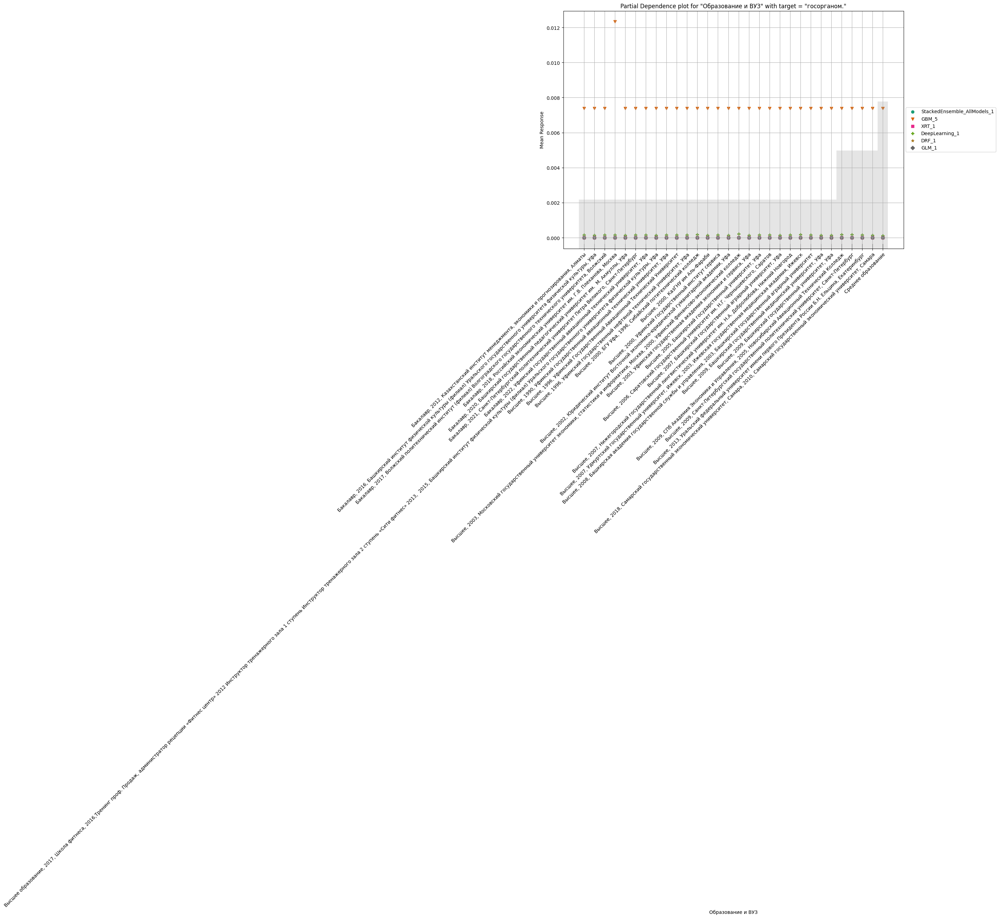

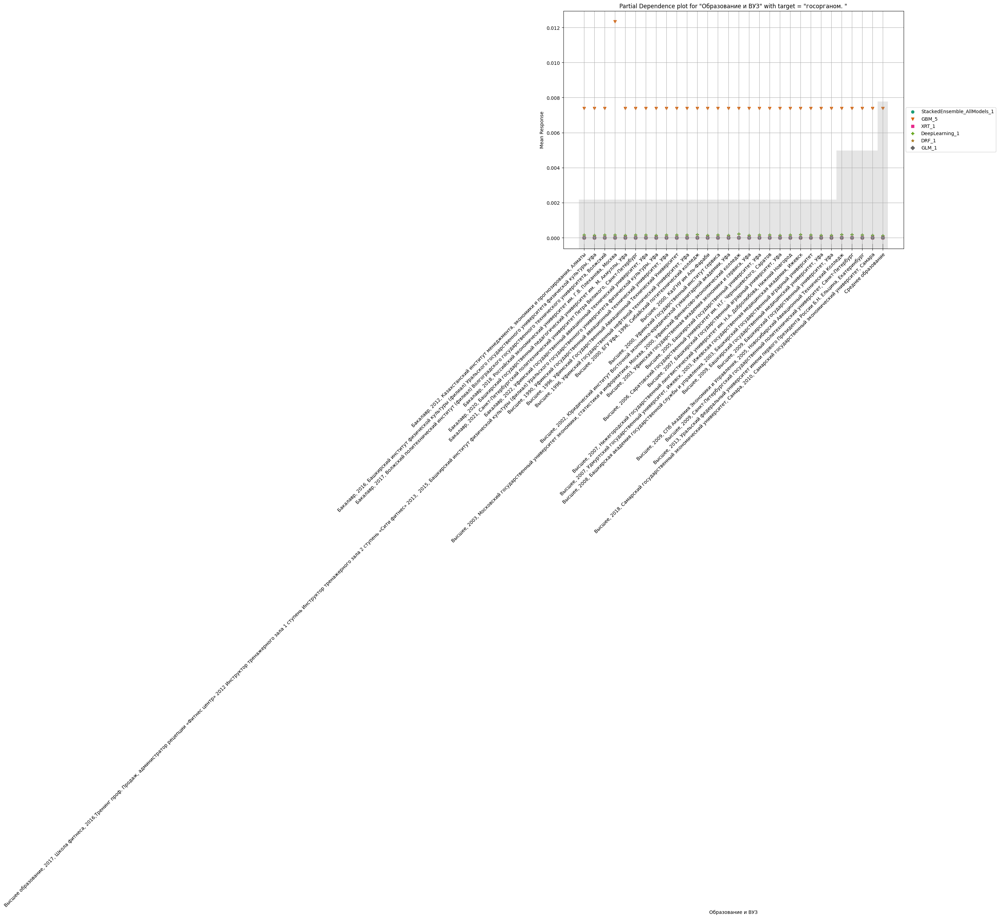

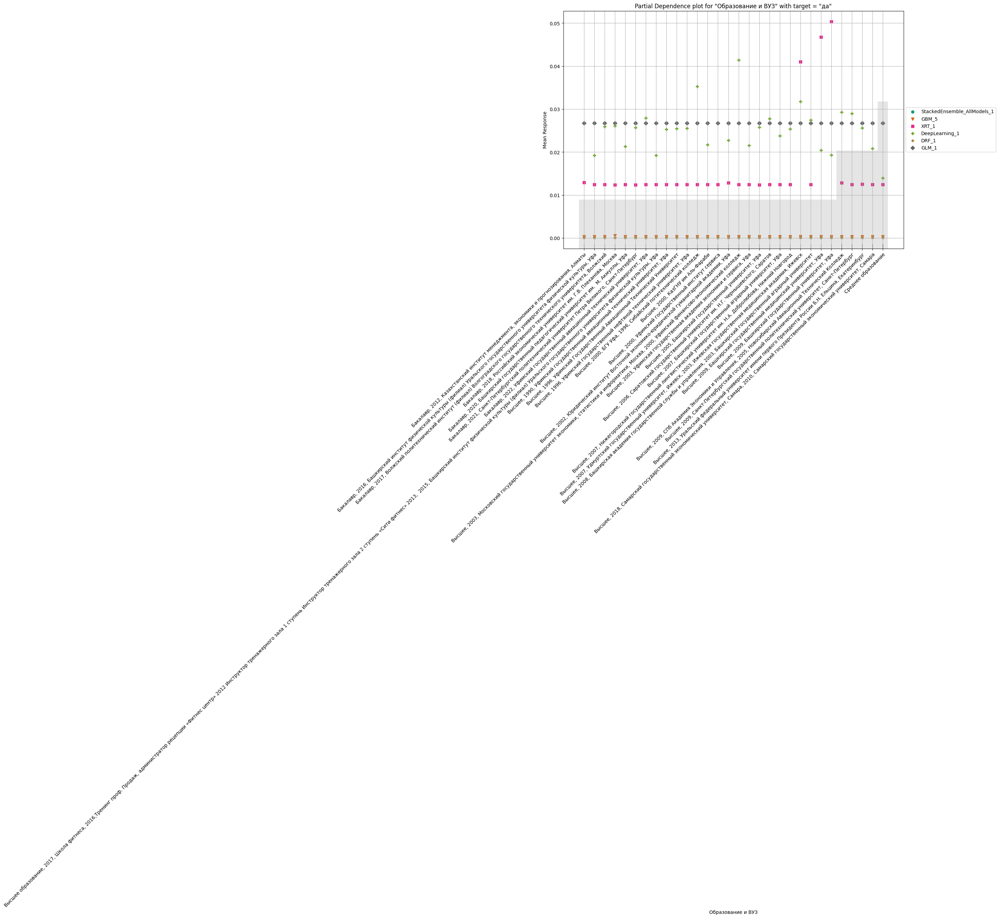

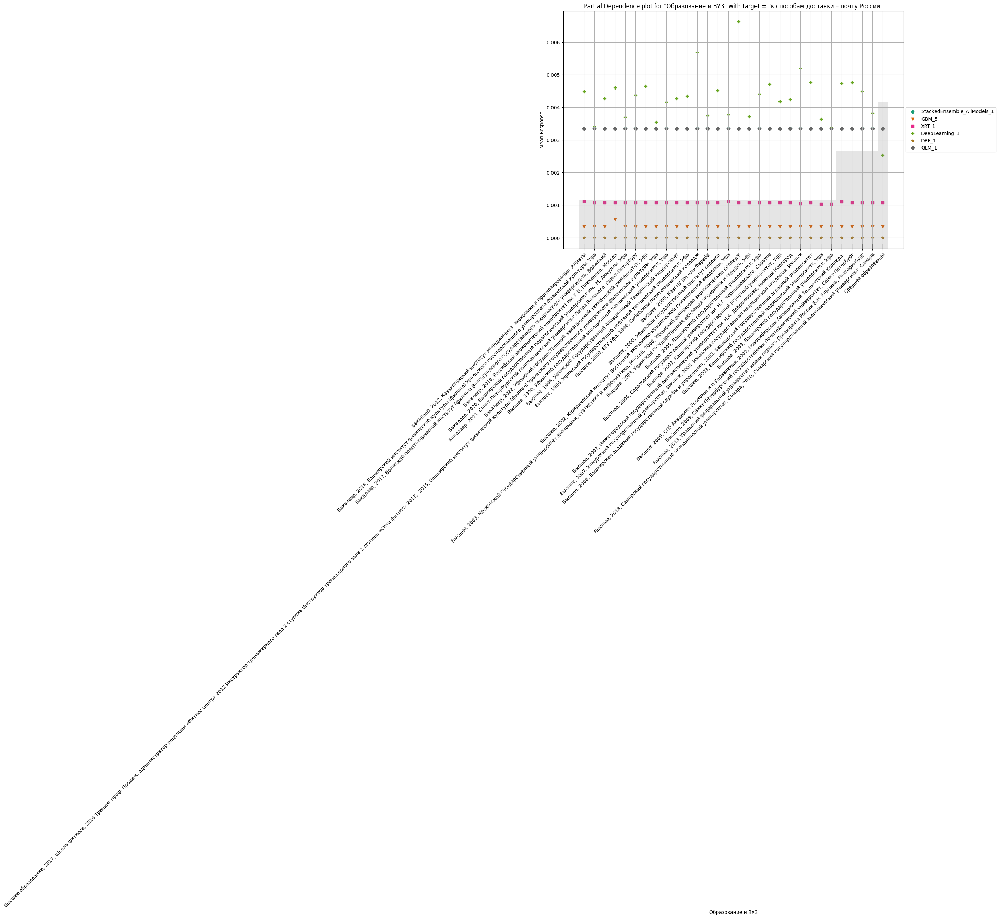

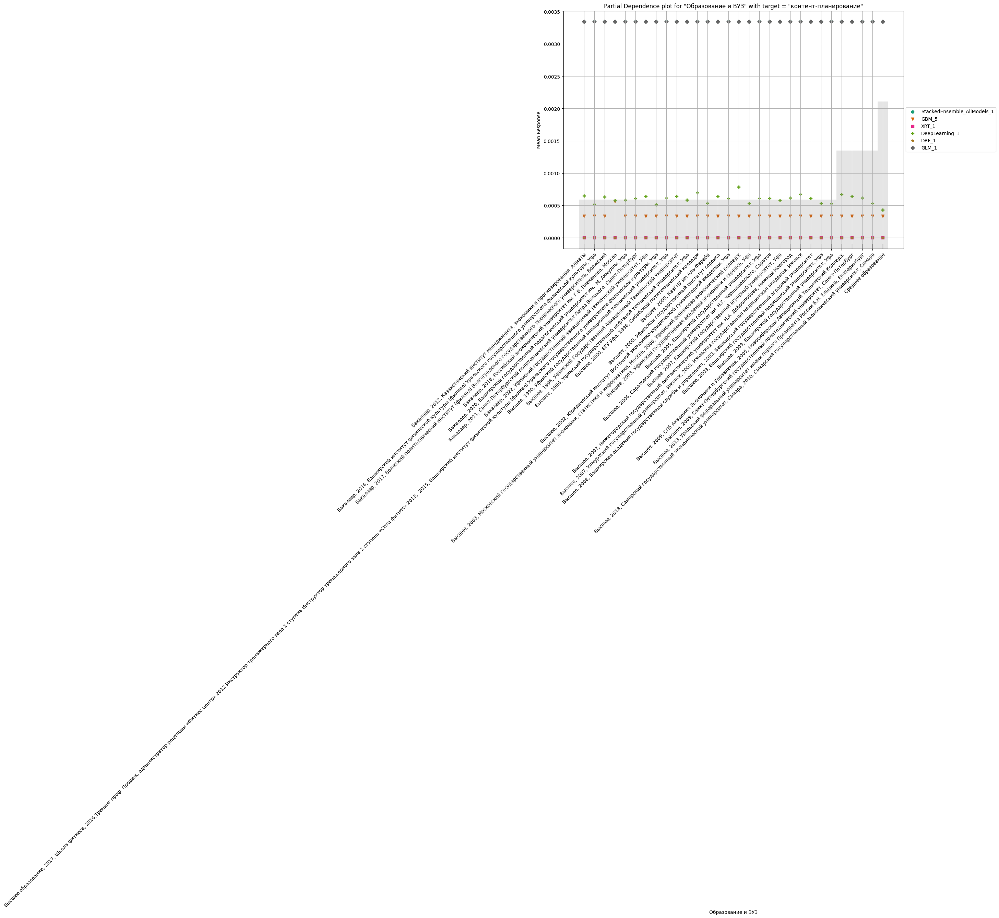

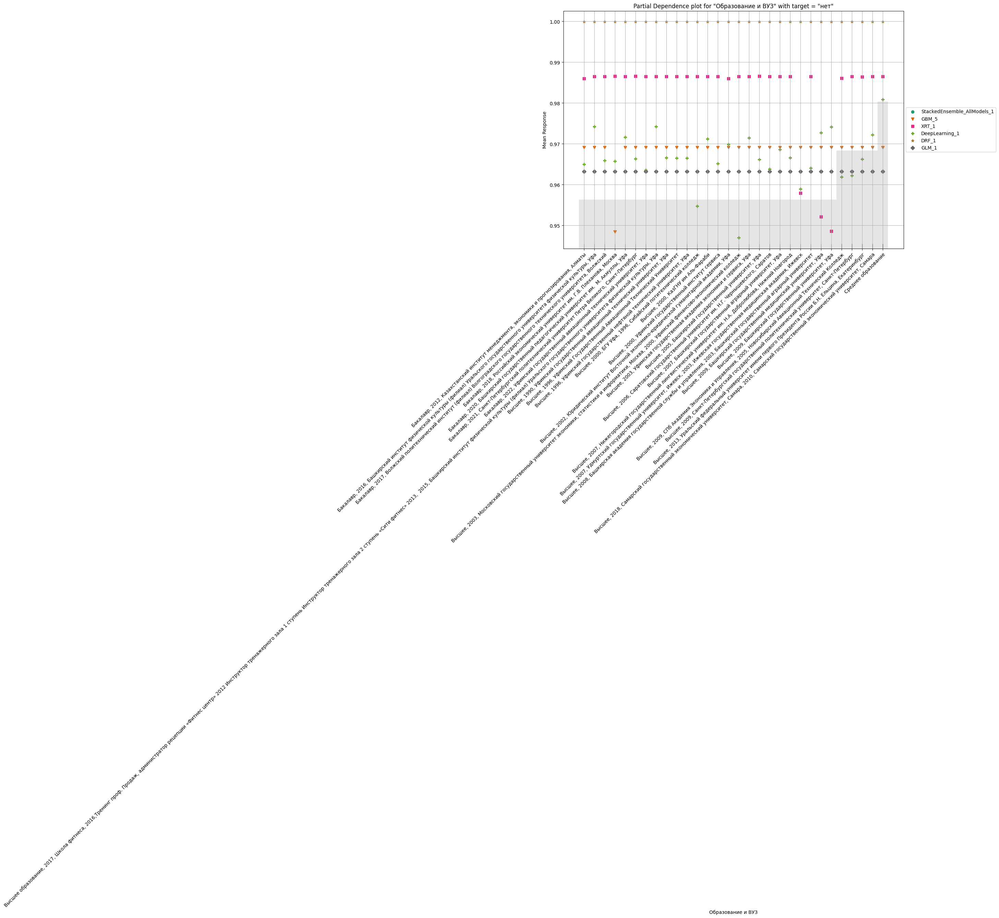

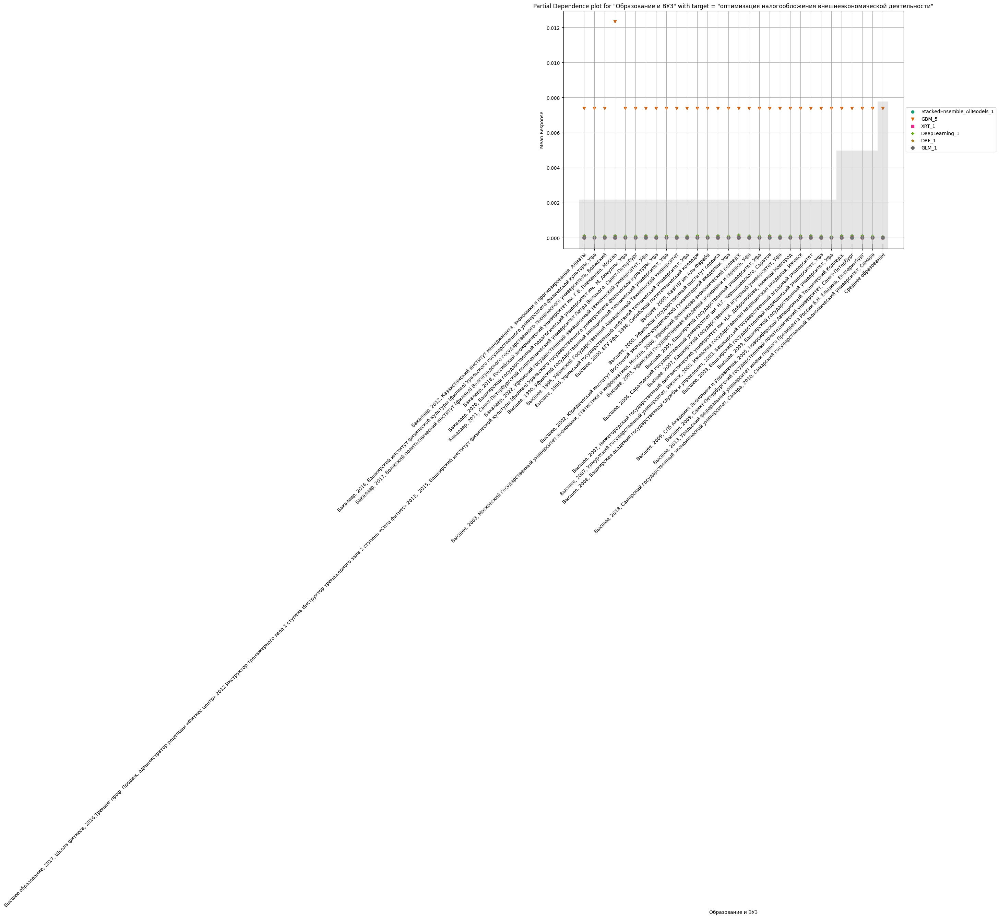

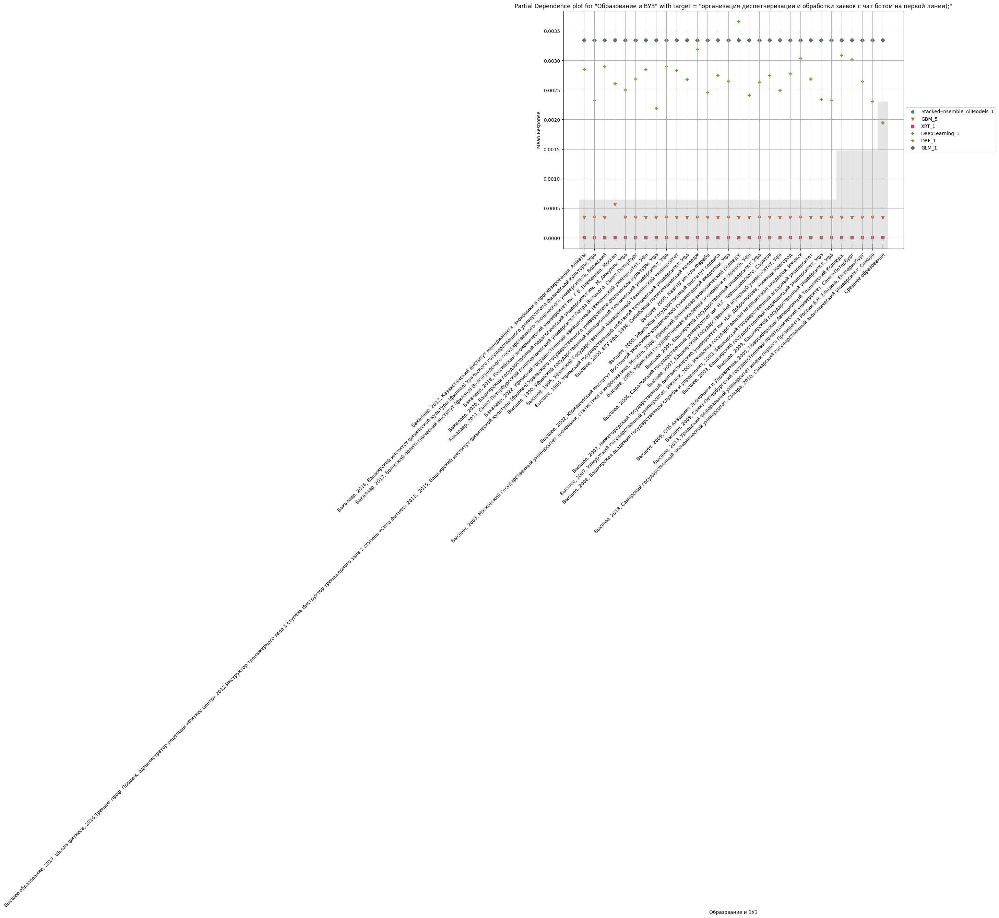

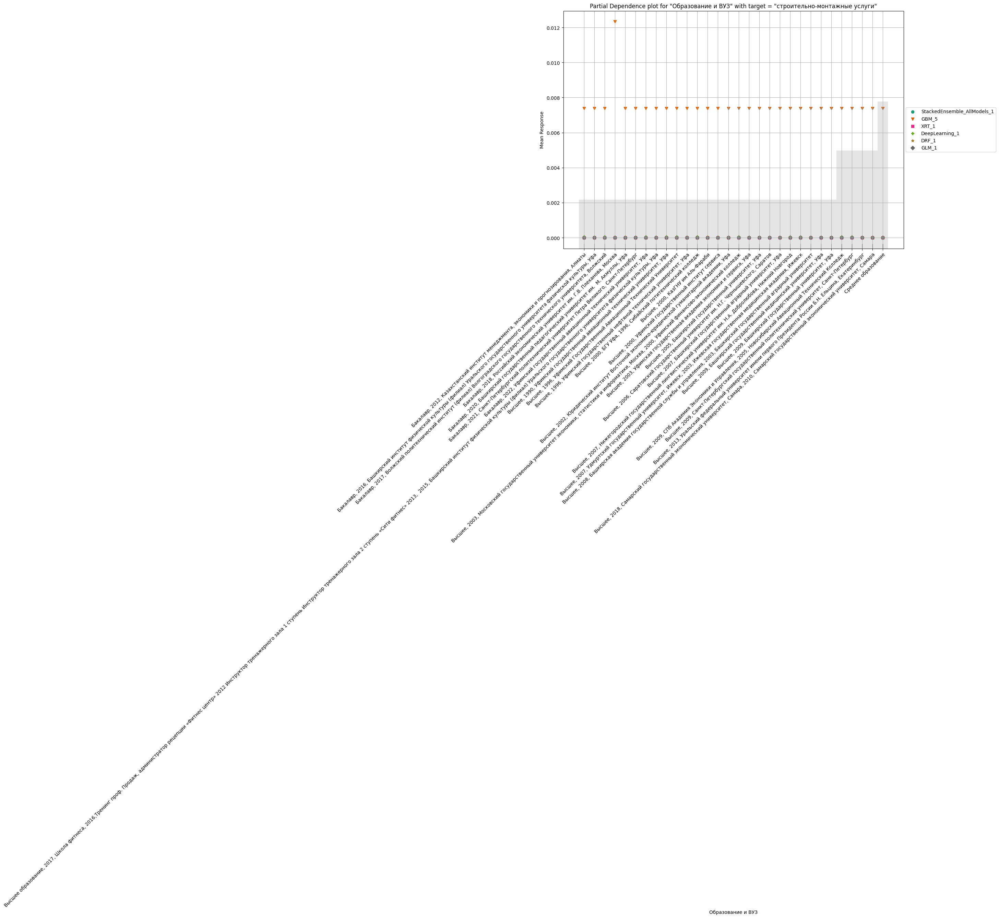

H2OServerError: ignored

<Figure size 1600x900 with 0 Axes>

In [ ]:
aml_1.explain(test)

# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_AllModels_1_AutoML_1_20230625_134459

госорганом.,госорганом.,да,к способам доставки – почту России,контент-планирование,нет,оптимизация налогообложения внешнеэкономической деятельности,организация диспетчеризации и обработки заявок с чат ботом на первой линии);,строительно-монтажные услуги,Error,Rate
0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1 / 1
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0,2 / 2
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,95.0,0.0,0.0,0.0,0.0,0 / 95
0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1 / 1
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,99.0,0.0,0.0,0.0,0.0404040,4 / 99


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

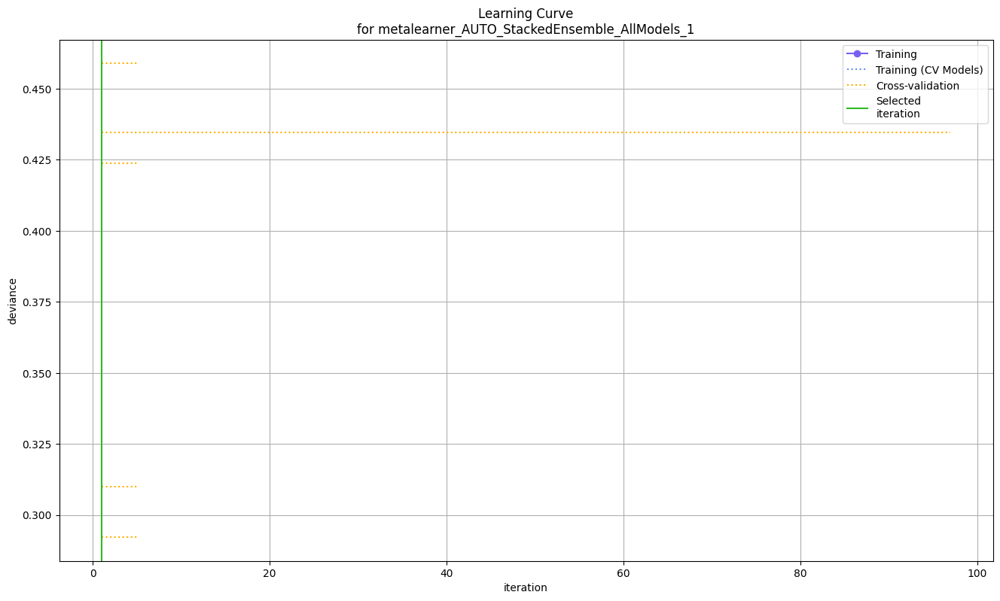

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

H2OServerError: ignored

<Figure size 1600x900 with 0 Axes>

In [ ]:
best_model_1.explain(test)

In [ ]:
perf = aml_1.leader.model_performance(test)
print(perf)

ModelMetricsMultinomialGLM: stackedensemble
** Reported on test data. **

MSE: 0.04063622545518724
RMSE: 0.20158428871116726
LogLoss: 0.8068732395196296
Null degrees of freedom: 98
Residual degrees of freedom: 90
Null deviance: Infinity
Residual deviance: Infinity
AUC table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).
AUCPR table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).

Confusion Matrix: Row labels: Actual class; Column labels: Predicted class
госорганом.    госорганом.     да    к способам доставки – почту России    контент-планирование    нет    оптимизация налогообложения внешнеэкономической деятельности    организация диспетчеризации и обработки заявок с чат ботом на первой линии);    строительно-монтажные услуги    Error     Rate
-------------  -------------- 

### Результат ответа

In [ ]:
preds = aml_1.predict(test)
print(preds)

stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%
predict      госорганом.    госорганом.          да    к способам доставки – почту России    контент-планирование       нет    оптимизация налогообложения внешнеэкономической деятельности    организация диспетчеризации и обработки заявок с чат ботом на первой линии);    строительно-монтажные услуги
нет                    0               0  0.0267559                            0.00334448              0.00334448  0.963211                                                               0                                                                      0.00334448                               0
нет                    0               0  0.0267559                            0.00334448              0.00334448  0.963211                                                               0                                                                      0.00334448                               0
нет  

In [ ]:
h2o.model.models.regression.h2o_mean_absolute_error(test[y].apply(lambda x: x=='да', axis=0),preds["predict"].apply(lambda x: x=='да', axis=0))

0.009009009009009007

### Предварительно обработаем

In [ ]:
data = pd.read_excel (r'dataS.xlsx', index_col=0)
#Если необходимо переименовать
data.columns = ['Response_date', 'Gender', 'Salary', 'Job', 'City', 'Employment', 'Schedule', 'Experience', 'Last_place', 'Position', 'Tasks', 'AboutMe', 'Skills', 'Education',  'Update_resume', 'Suitable']

data = convertDataSet(data)

data = data.drop(columns=['Response_date'])
data = data.drop(columns=['Update_resume'])

data.to_csv('data.csv')
data.head(40)

,Gender,Salary,Job,City,Experience,Last_place,Position,Tasks,AboutMe,Skills,...,Employment_2,Employment_3,Employment_4,Employment_5,Employment_6,Schedule_0,Schedule_1,Schedule_2,Schedule_3,Schedule_4
8,0,0,"[2, 3, 4]","[14, 6, 2, 5, 6, 2, 4]",76,"[14, 15]","[16, 17, 4]","[1, 1, 1, 1, 4, 1, 247, 1, 689, 1, 248, 1, 108...","[7, 270, 271, 3, 272, 273, 2, 274, 130, 79, 13...","[108, 34, 46, 109, 47, 46, 57, 46, 146, 243, 1...",...,1,1,1,1,1,1,0,1,1,1
26,1,0,"[2, 3, 4]","[18, 3, 2, 5, 3, 2, 4]",141,"[16, 17, 18, 19, 20, 21, 22]","[18, 2, 3]","[969, 35, 1, 6, 719, 425, 720, 555, 182, 426, ...",[],"[3, 26, 48, 74, 60, 15, 7, 4, 2, 5, 150, 3, 61...",...,1,0,1,1,1,1,0,1,1,1
36,1,0,"[2, 3, 4]","[25, 3, 2, 5, 10, 11, 3, 2, 4]",146,"[2, 3, 4, 5, 6]","[19, 20, 21]","[458, 1, 377, 753, 579, 14, 1, 2, 1, 754, 1, 1...","[3, 37, 139, 303, 304, 305, 2, 306, 307, 140, ...","[256, 257, 59, 18, 78, 258, 118, 43, 259, 62, ...",...,1,0,1,1,1,1,1,1,0,1
4,1,150000,"[2, 3, 4]","[26, 15, 16, 3, 2, 4]",69,"[2, 3, 4, 5, 6]","[2, 10, 3]","[467, 110, 1, 71, 53, 1, 1, 1, 109, 2, 319, 1,...","[334, 335, 56, 2, 145, 4, 336, 337, 338, 339, ...","[3, 51, 158, 159, 14, 58, 277, 160, 278, 10, 8...",...,1,1,1,1,1,1,0,1,1,1
34,1,0,"[2, 3, 4]","[10, 11, 9, 27]",127,"[7, 23]","[2, 5]","[19, 1, 1, 274, 1, 94, 1, 998, 999, 16, 43, 45...",[],"[3, 8, 22, 31, 27, 44, 10, 82, 17, 4, 2, 5, 20...",...,1,0,1,1,1,1,0,1,1,1
29,1,0,"[2, 3, 4]","[8, 3, 2, 5, 3, 2, 4]",102,"[24, 10, 25]","[6, 11]","[213, 157, 95, 600, 119, 601, 390, 325, 105, 6...","[16, 82, 8, 24, 164, 381, 55, 3, 382, 383, 2, ...","[42, 26, 25, 35, 18, 110, 38, 2, 123, 286, 160...",...,1,0,1,1,1,1,0,1,1,1
30,1,1,"[2, 3, 4]","[19, 7, 3, 2, 5, 7, 3, 2, 4]",22,"[7, 26]","[4, 7, 22]","[1, 35, 234, 190, 53, 123, 1, 17, 17, 4, 302, ...","[40, 42, 433, 434, 435, 95, 436, 177, 57, 42, ...","[290, 12, 168, 291, 292, 26, 169, 13, 23, 293,...",...,1,1,1,1,1,1,0,1,1,1
33,1,0,"[2, 3, 4]","[17, 3, 2, 5, 3, 2, 4]",168,[27],"[2, 3]","[259, 1, 135, 3, 620, 34, 1, 1, 204, 1, 491, 1...","[486, 487, 81, 488, 99, 489, 490, 100, 27, 491...","[109, 47, 3, 8, 42, 117, 112, 19, 24, 113, 48,...",...,1,1,1,1,1,1,0,1,1,1
0,0,90000,"[2, 3, 4]","[28, 7, 6, 2, 5, 7, 6, 2, 4]",70,"[28, 29, 30, 31]","[4, 7, 12]","[557, 152, 159, 43, 159, 45, 159, 1, 72, 627, ...",[],"[14, 58, 3, 8, 17, 4, 2, 5, 27, 44, 10, 82, 30...",...,1,1,1,1,1,1,0,1,1,1
38,1,0,"[2, 3, 4]","[8, 9, 29, 3, 2, 5, 3, 2, 4]",28,"[32, 33]","[2, 3]","[1, 3, 308, 83, 2, 399, 295, 13, 440, 1, 64, 4...","[23, 91, 4, 80, 164, 12, 55, 3, 195, 196, 101,...","[125, 87, 88, 89, 90, 36, 10, 32, 52, 170, 171...",...,1,1,1,1,1,1,0,1,1,1


In [ ]:
df = h2o.import_file("data.csv")
df = df[:,1:]

df.describe ()

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


Rows:40
Cols:28

,Gender,Salary,Job,City,Experience,Last_place,Position,AboutMe,Skills,Education,Suitable,Birth,Age,DegreeOfStudy,YearOfGraduation,Employment_0,Employment_1,Employment_2,Employment_3,Employment_4,Employment_5,Employment_6,Schedule_0,Schedule_1,Schedule_2,Schedule_3,Schedule_4
type,int,int,enum,enum,int,enum,enum,enum,string,string,enum,int,int,enum,int,int,int,int,int,int,int,int,int,int,int,int,int
mins,0.0,0.0,,,22.0,,,,NaN,NaN,,1687702407.0,0.0,,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0
mean,0.7,45000.025,,,103.85,,,,NaN,NaN,,1687702407.0,28.275,,1965.95,0.45,1.0,1.0,0.6,1.0,0.95,1.0,0.925,0.275,1.0,0.8,1.0
maxs,1.0,380000.0,,,234.0,,,,NaN,NaN,,1687702407.0,41.0,,2023.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
sigma,0.4640954808922571,84002.42823123002,,,45.76223389741864,,,,NaN,NaN,,0.0,10.56842782379038,,318.84012149809985,0.5038314736557788,0.0,0.0,0.4961389383568338,0.0,0.22072142786315224,0.0,0.2667467828369185,0.4522025867763026,0.0,0.40509574683346666,0.0
zeros,12,26,,,0,,,,0,0,,0,4,,1,22,0,0,16,0,2,0,3,29,0,8,0
missing,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0.0,0.0,"[2, 3, 4]","[14, 6, 2, 5, 6, 2, 4]",76.0,"[14, 15]","[16, 17, 4]","[7, 270, 271, 3, 272, 273, 2, 274, 130, 79, 131, 55, 56, 3, 35, 5, 275, 276, 3, 277, 2, 278, 279, 4, 132, 2, 280, 281, 7, 133, 80, 3, 35, 282, 283, 284, 285, 3, 286, 287, 288, 289, 290, 291, 2, 292, 134, 293, 7, 15, 294, 295, 7, 135, 3, 136, 2, 137, 10, 296, 4, 297, 3, 298, 138, 81, 4, 299, 3, 136, 57, 137, 10, 300, 36, 58, 10, 301, 82, 8, 302]","[108, 34, 46, 109, 47, 46, 57, 46, 146, 243, 18, 110, 14, 58, 25, 35, 111, 72, 59, 244, 245, 4, 41, 46, 147, 73, 17, 4, 2, 5, 46, 148, 149, 246, 247]","[3, 55, 56, 22, 23, 36, 5, 7, 24, 37, 2, 22, 23, 38, 5]",нет,1687702407.0,29.0,[2],2023.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0
1,1.0,0.0,"[2, 3, 4]","[18, 3, 2, 5, 3, 2, 4]",141.0,"[16, 17, 18, 19, 20, 21, 22]","[18, 2, 3]",[],"[3, 26, 48, 74, 60, 15, 7, 4, 2, 5, 150, 3, 61, 8, 36, 10, 112, 19, 24, 113, 6, 49, 19, 6, 19, 75, 248, 249, 250, 114, 251, 252, 6, 11, 151, 253, 115, 6, 152, 254, 60, 6, 50, 14, 12, 116, 42, 117, 76, 37, 76, 73, 255, 77, 153]","[3, 25, 26, 4, 2, 17]",нет,1687702407.0,36.0,[2],2010.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0
2,1.0,0.0,"[2, 3, 4]","[25, 3, 2, 5, 10, 11, 3, 2, 4]",146.0,"[2, 3, 4, 5, 6]","[19, 20, 21]","[3, 37, 139, 303, 304, 305, 2, 306, 307, 140, 3, 141, 308, 309, 9, 3, 12, 310, 311, 312, 313, 5, 314, 315, 59, 316, 7, 142, 143, 38, 317, 16, 318, 319, 2, 320, 321, 7, 322, 83, 2, 4, 323, 324, 4, 325, 326, 144, 5, 84, 327, 328, 329, 330, 331, 2, 20, 16, 332, 333]","[256, 257, 59, 18, 78, 258, 118, 43, 259, 62, 118, 119, 260, 261, 62, 118, 154, 262, 263, 155, 264, 265, 2, 79, 120, 119, 266, 119, 155, 46, 156, 59, 62, 267, 59, 148, 268, 62, 269, 270, 271, 272, 63, 273, 274, 2, 157, 275, 276, 15, 7, 4, 2, 5, 154, 59]","[27, 81]",нет,1687702407.0,39.0,[],0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0


In [ ]:
train, test, valid = df.split_frame ( ratios = [ .7 , .20 ])

y = "Suitable"
x_train= train.columns
x_train.remove(y)


In [ ]:
aml_2 = H2OAutoML(max_models = 20, seed = 1)
aml_2.train(x = x_train, y = y, training_frame = train)

AutoML progress: |
14:13:50.564: _train param, Dropping bad and constant columns: [Schedule_4, Tasks, Schedule_2, Skills, Education, Employment_2, Employment_1, Employment_4, Employment_6, Birth]


14:13:52.18: _train param, Dropping bad and constant columns: [Schedule_4, Tasks, Schedule_2, Skills, Education, Employment_2, Employment_1, Employment_4, Employment_6, Birth]

█
14:13:53.248: _train param, Dropping bad and constant columns: [Schedule_4, Tasks, Schedule_2, Skills, Education, Employment_2, Employment_1, Employment_4, Employment_6, Birth]
14:13:53.248: _min_rows param, The dataset size is too small to split for min_rows=100.0: must have at least 200.0 (weighted) rows, but have only 32.0.
14:13:53.250: _train param, Dropping bad and constant columns: [Schedule_4, Tasks, Schedule_2, Skills, Education, Employment_2, Employment_1, Employment_4, Employment_6, Birth]

█
14:13:54.877: _train param, Dropping bad and constant columns: [Schedule_4, Tasks, Schedule_2, Skills, Education, 

key,value
Stacking strategy,cross_validation
Number of base models (used / total),4/20
# GBM base models (used / total),3/6
# XGBoost base models (used / total),0/7
# DeepLearning base models (used / total),1/4
# DRF base models (used / total),0/2
# GLM base models (used / total),0/1
Metalearner algorithm,GLM
Metalearner fold assignment scheme,Random
Metalearner nfolds,5


In [ ]:
best_model_2 = aml_2.leader
lb = aml_2.leaderboard
lb.head()

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse
StackedEnsemble_AllModels_1_AutoML_2_20230625_141350,0.865385,0.303292,0.961302,0.166667,0.297972,0.0887872
GBM_3_AutoML_2_20230625_141350,0.855769,0.456458,0.964662,0.333333,0.367874,0.135331
StackedEnsemble_BestOfFamily_1_AutoML_2_20230625_141350,0.852564,0.293782,0.958545,0.166667,0.292142,0.0853468
GBM_2_AutoML_2_20230625_141350,0.836538,0.49395,0.960691,0.333333,0.374344,0.140133
GBM_4_AutoML_2_20230625_141350,0.820513,0.480954,0.956876,0.333333,0.372019,0.138398
GBM_grid_1_AutoML_2_20230625_141350_model_2,0.791667,0.579244,0.946352,0.333333,0.394469,0.155606
GBM_grid_1_AutoML_2_20230625_141350_model_1,0.775641,0.457468,0.943957,0.416667,0.379928,0.144345
GBM_5_AutoML_2_20230625_141350,0.753205,0.610901,0.93624,0.333333,0.406927,0.16559
DeepLearning_grid_1_AutoML_2_20230625_141350_model_1,0.737179,0.579914,0.923815,0.416667,0.375313,0.14086
DRF_1_AutoML_2_20230625_141350,0.653846,0.684067,0.893255,0.333333,0.399964,0.159971


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_AllModels_1_AutoML_2_20230625_141350

,да,нет,Error,Rate
да,0.0,1.0,1.0,(1.0/1.0)
нет,0.0,6.0,0.0,(0.0/6.0)
Total,0.0,7.0,0.1429,(1.0/7.0)


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

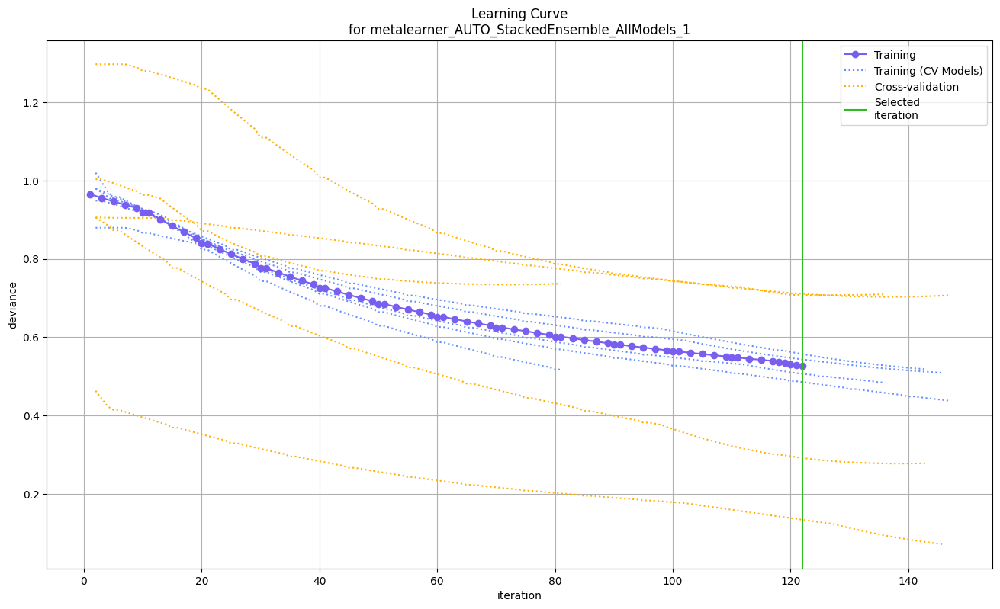

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

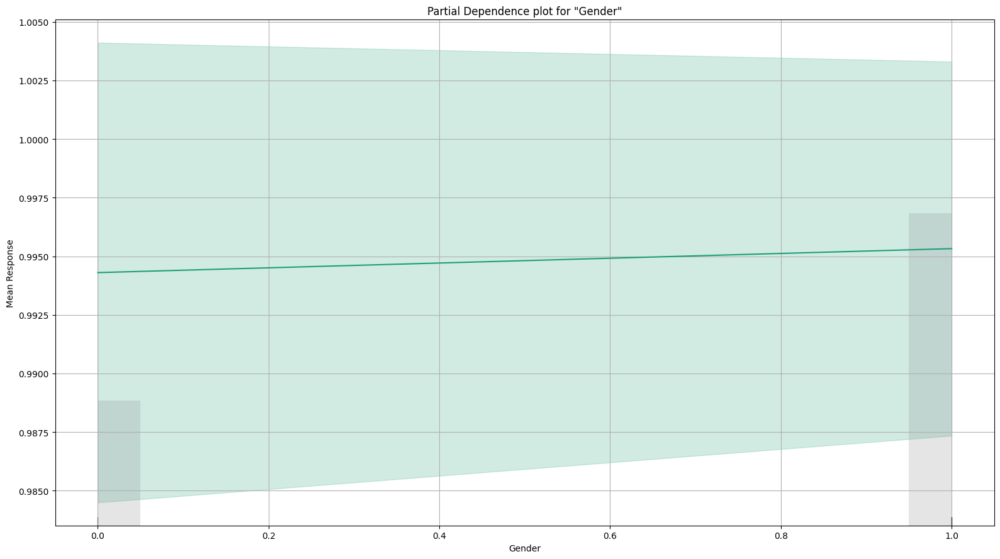

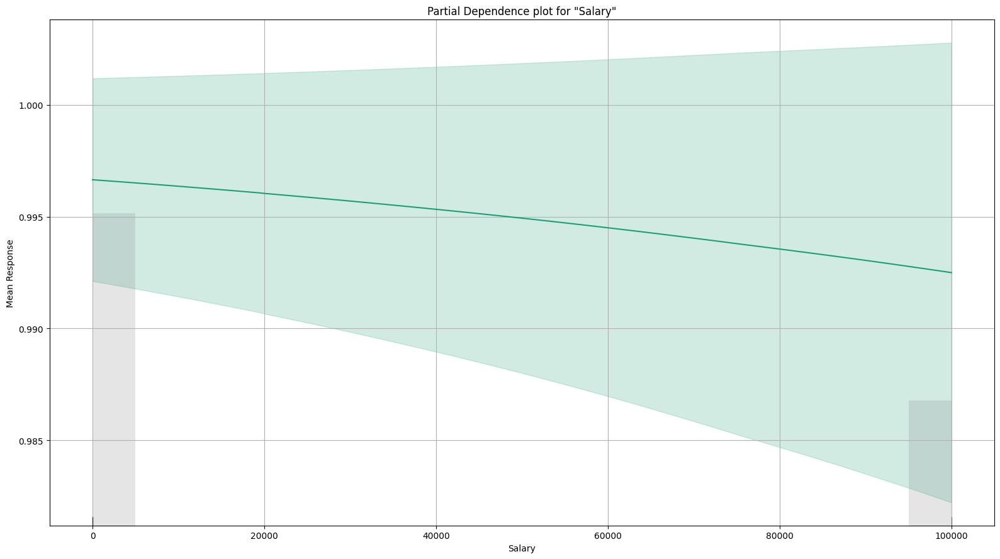

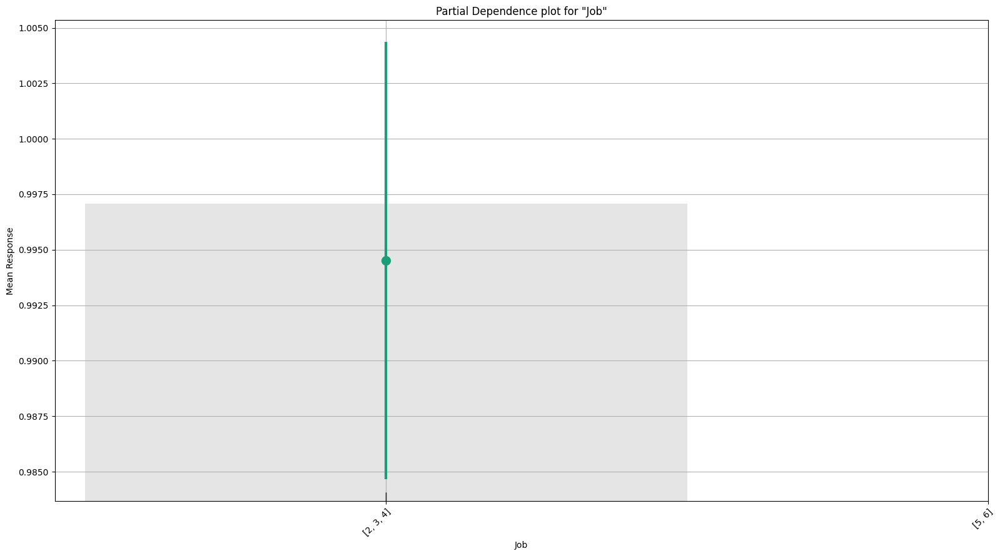

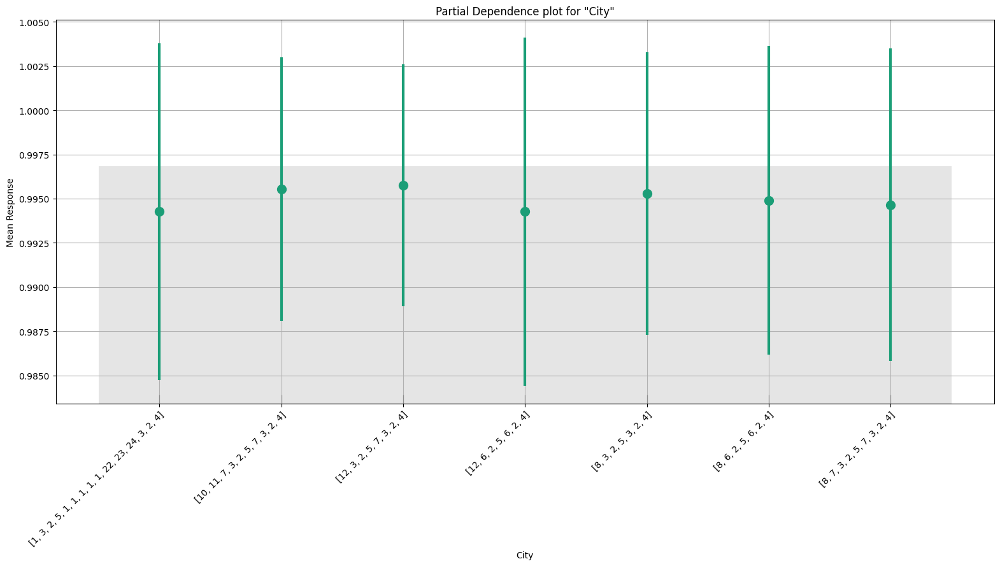

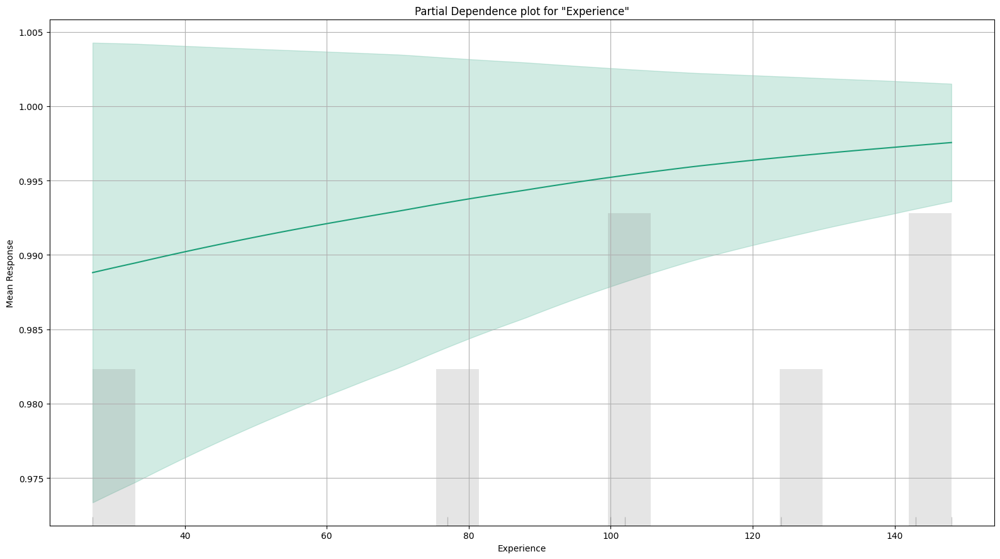

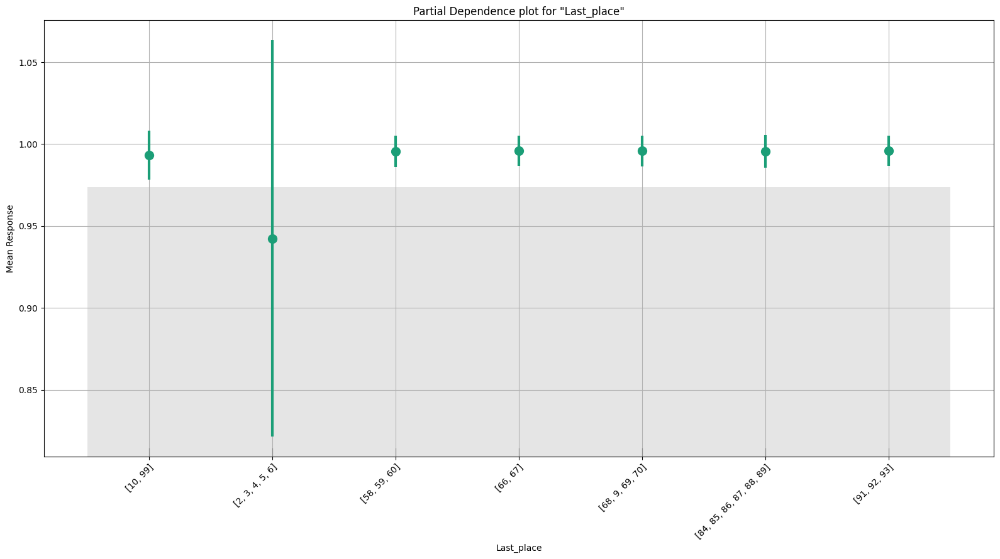

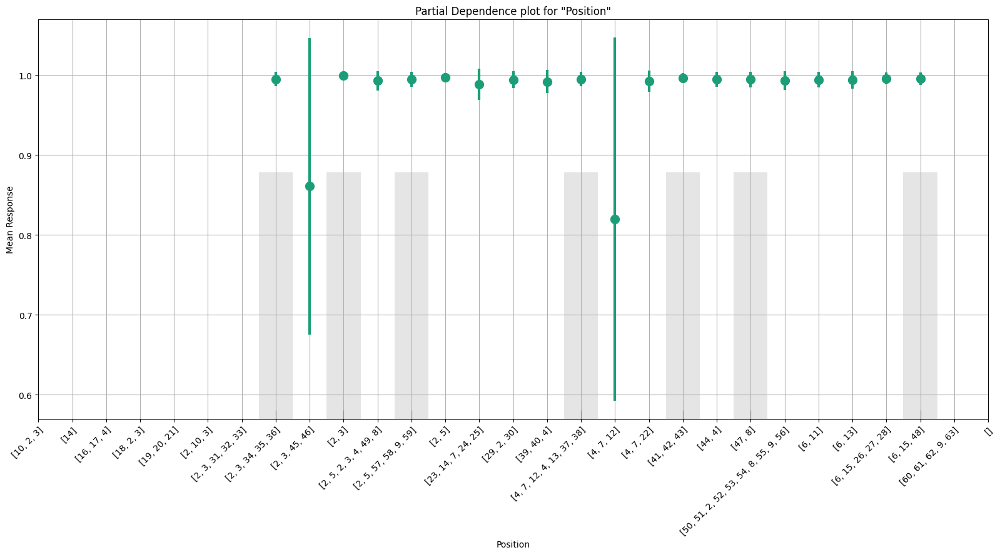

/usr/local/lib/python3.10/dist-packages/h2o/explanation/_explain.py:1287: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


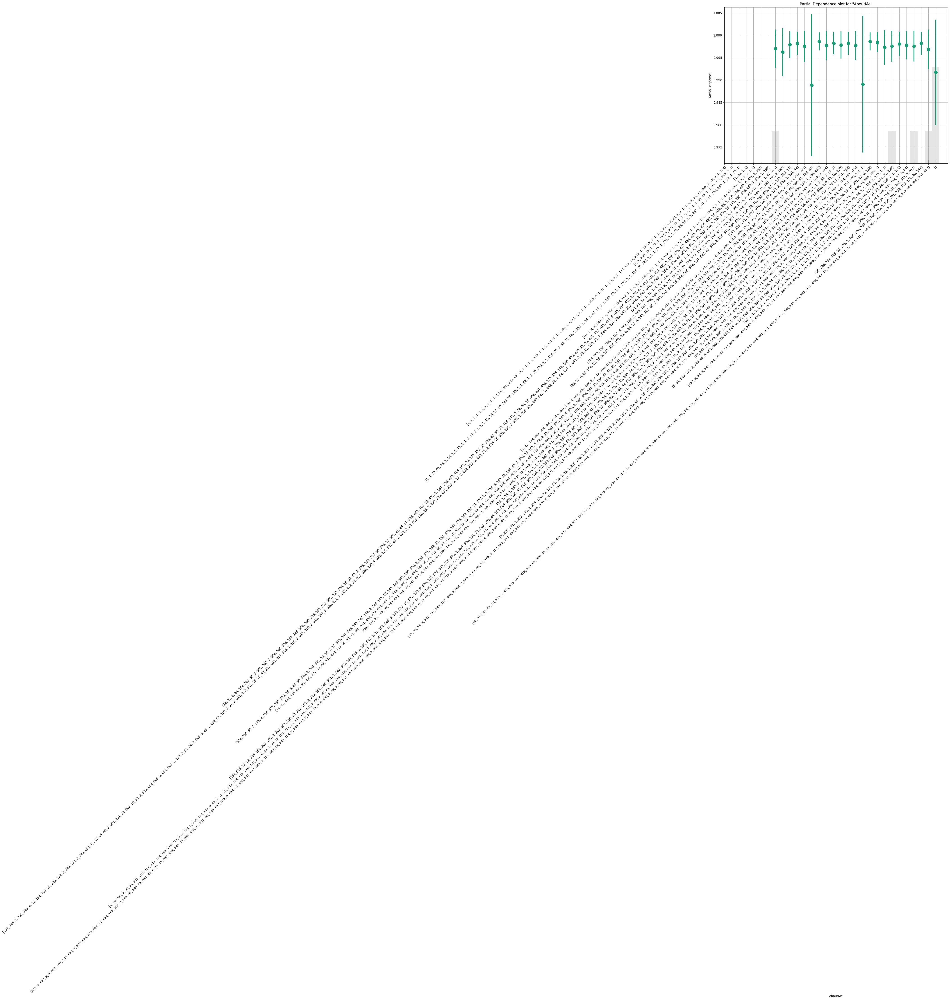

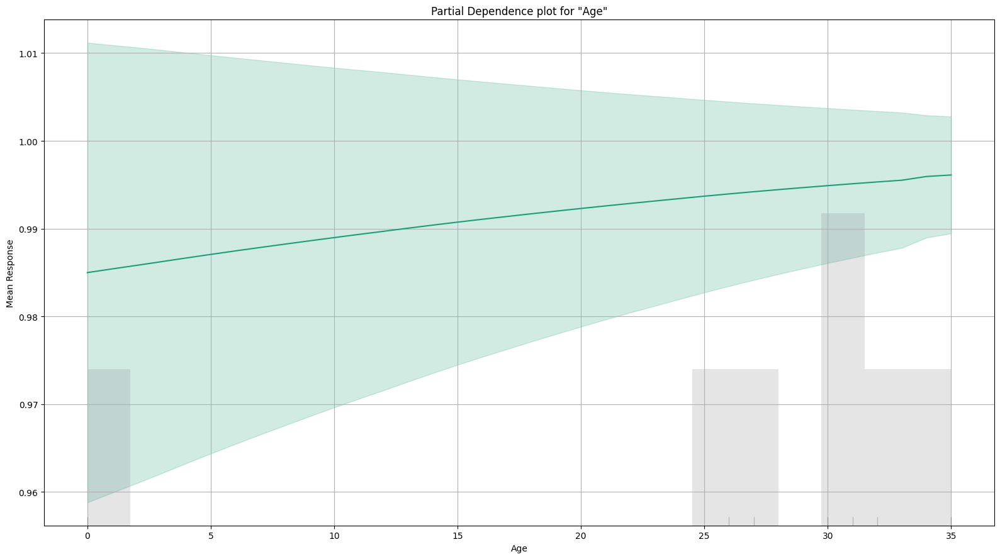

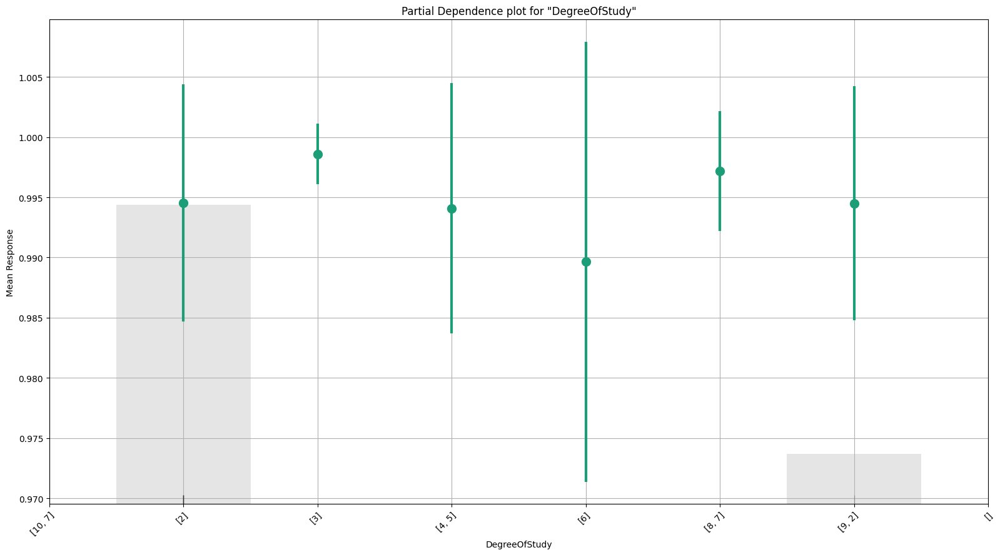

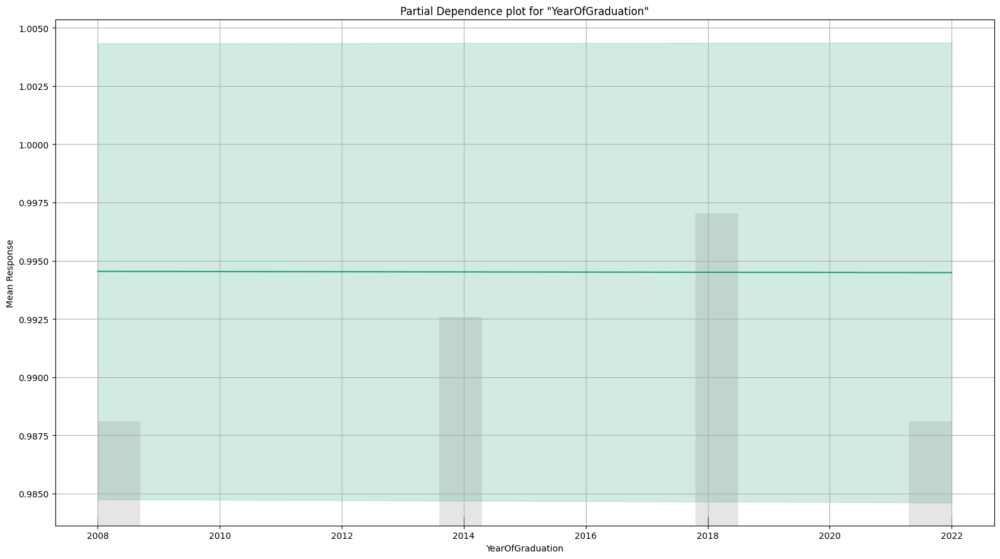

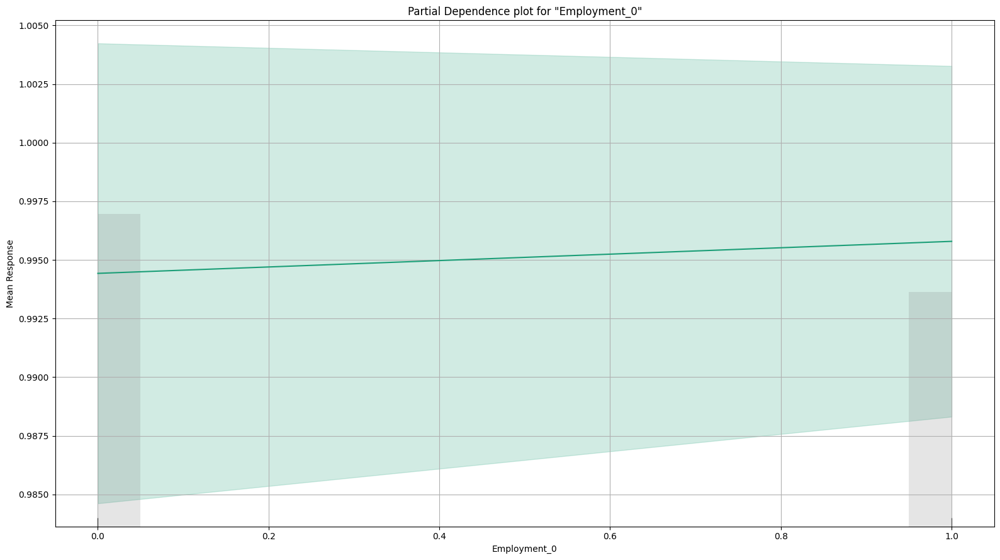

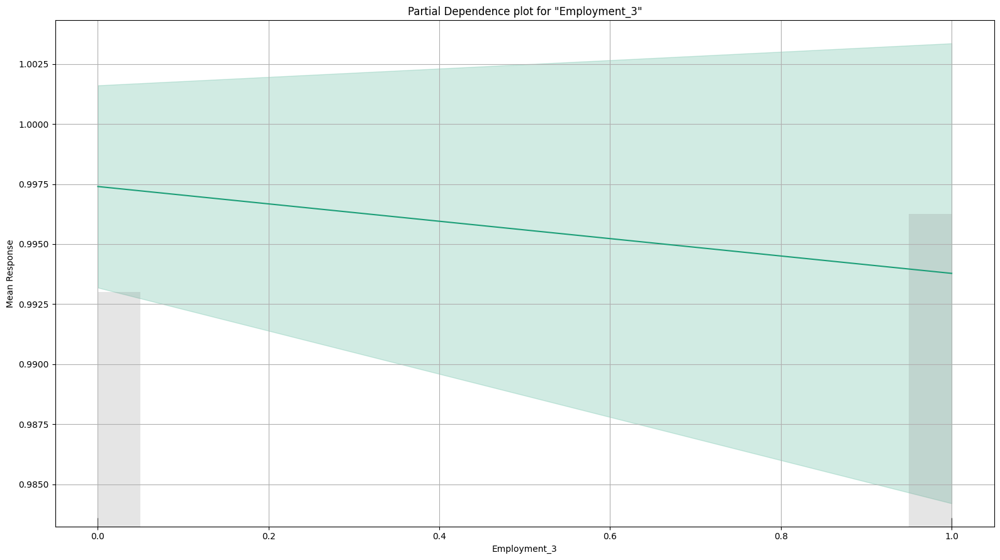

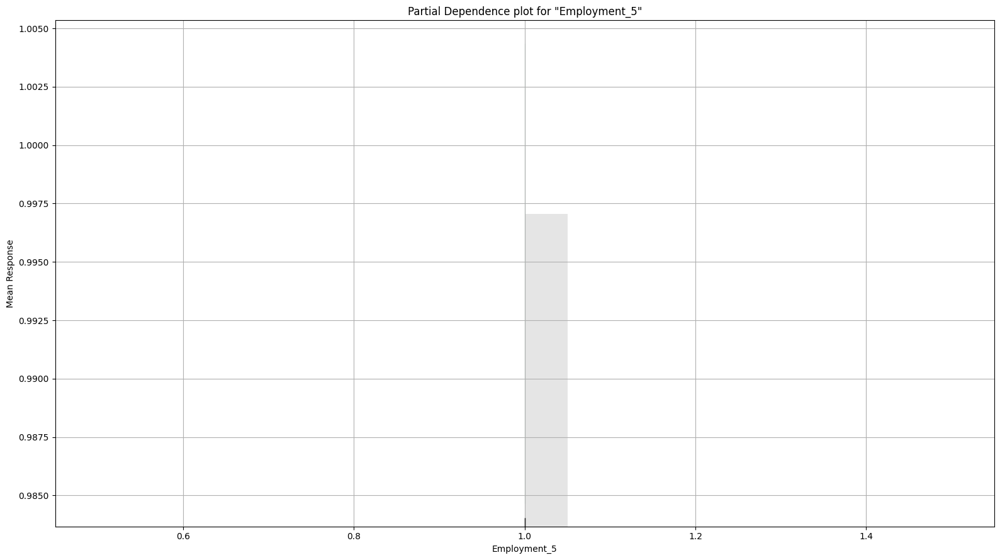

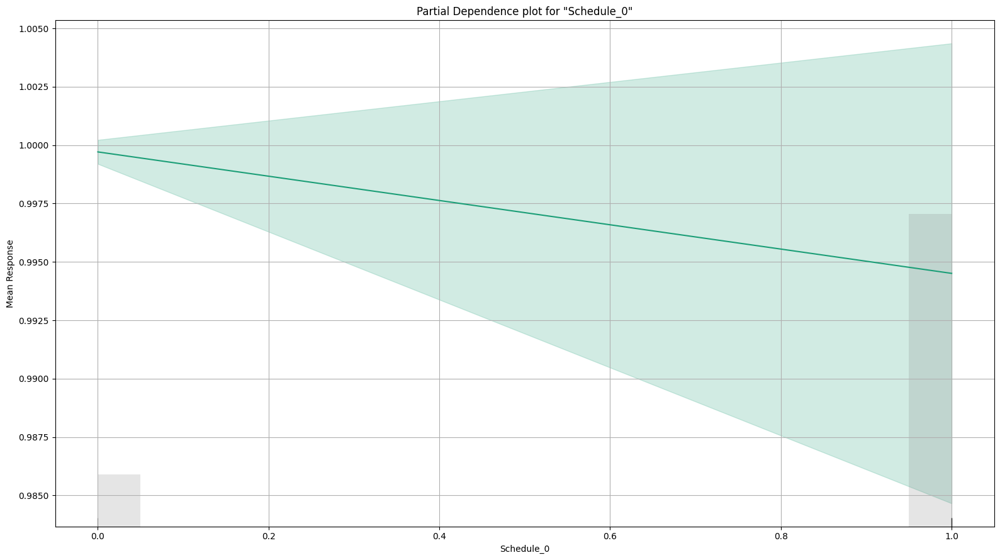

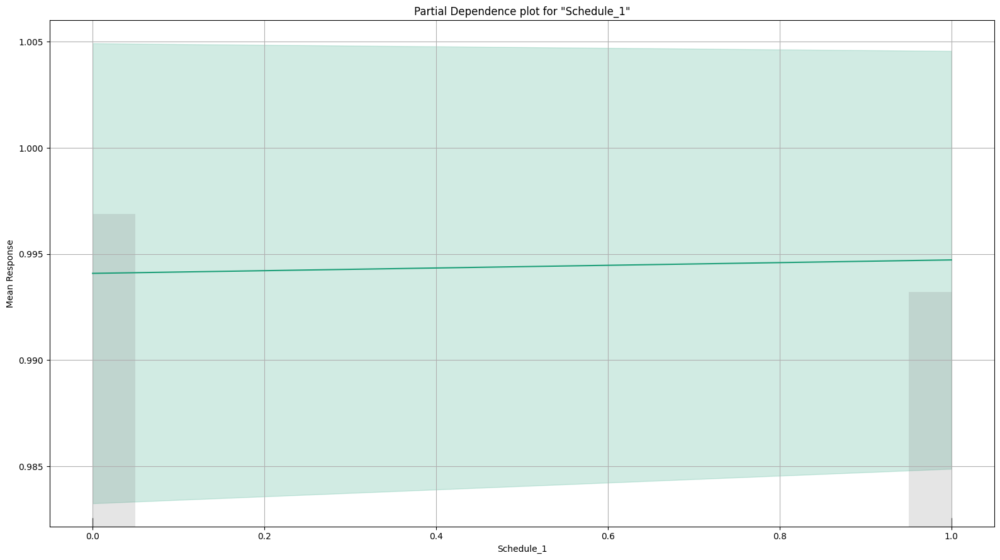

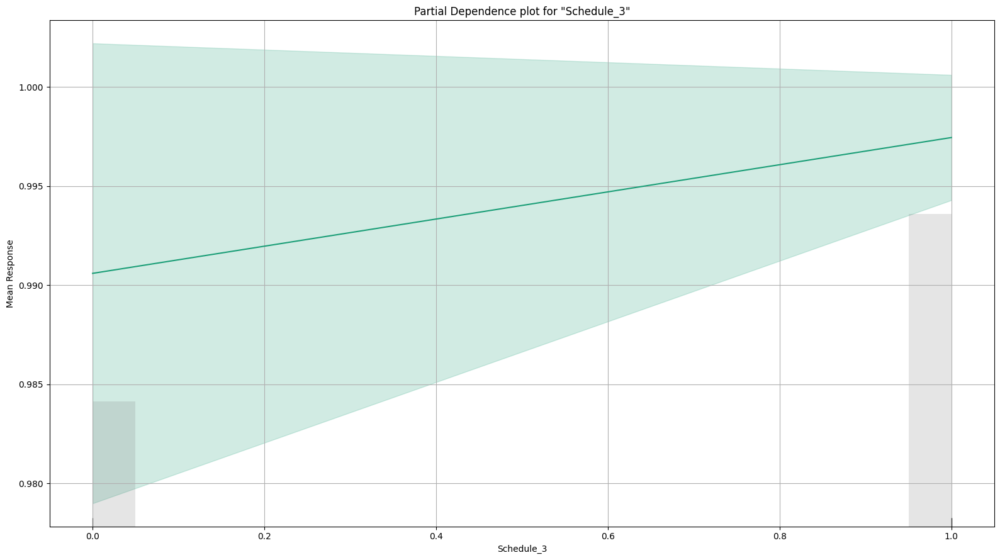

# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_AllModels_1_AutoML_2_20230625_141350

,да,нет,Error,Rate
да,0.0,1.0,1.0,(1.0/1.0)
нет,0.0,6.0,0.0,(0.0/6.0)
Total,0.0,7.0,0.1429,(1.0/7.0)


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

In [ ]:
best_model_2.explain(test)

In [ ]:
perf = aml_2.leader.model_performance(test)
print(perf)

ModelMetricsBinomialGLM: stackedensemble
** Reported on test data. **

MSE: 0.14245014211924792
RMSE: 0.37742567760984136
LogLoss: 0.9064811645380464
AUC: 0.6666666666666666
AUCPR: 0.9439212938964644
Gini: 0.33333333333333326
Null degrees of freedom: 6
Residual degrees of freedom: 2
Null deviance: 5.839625244482278
Residual deviance: 12.690736303532649
AIC: 22.69073630353265

Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.972732429679807
       да    нет    Error    Rate
-----  ----  -----  -------  ---------
да     0     1      1        (1.0/1.0)
нет    0     6      0        (0.0/6.0)
Total  0     7      0.1429   (1.0/7.0)

Maximum Metrics: Maximum metrics at their respective thresholds
metric                       threshold    value     idx
---------------------------  -----------  --------  -----
max f1                       0.972732     0.923077  6
max f2                       0.972732     0.967742  6
max f0point5                 0.998646     0.909091  3
max accuracy       

### Результат ответа

In [ ]:
preds = aml_2.predict(test)
print(preds)

stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%
predict             да       нет
нет        0.00135404   0.998646
нет        0.00653497   0.993465
нет        2.43158e-05  0.999976
нет        0.000144089  0.999856
нет        0.0272676    0.972732
нет        0.00129022   0.99871
нет        0.00182103   0.998179
[7 rows x 3 columns]



In [ ]:
h2o.model.models.regression.h2o_mean_absolute_error(test["Suitable"].apply(lambda x: x=='да', axis=0),preds["predict"].apply(lambda x: x=='да', axis=0))

0.14285714285714285

## **Autokeras**

In [ ]:
data = pd.read_excel (r'dataS.xlsx', index_col=0)
#Если необходимо переименовать
data.columns = ['Response_date', 'Gender', 'Salary', 'Job', 'City', 'Employment', 'Schedule', 'Experience', 'Last_place', 'Position', 'Tasks', 'AboutMe', 'Skills', 'Education',  'Update_resume', 'Suitable']

data = convertDataSet(data)
#Suitable
#Список ответов делаем
listAnswers = []
#Обработаем отдельно колонку с ответами
for i, row in data.iterrows():
   a = 1 if str(row.Suitable).find('да') != -1 else 0
   listAnswers.append([a])
answers = np.array(listAnswers)
print(answers.shape)






(40, 1)


In [ ]:
dataset = takeDataSet(data)

print(dataset.shape)
# Разбиение на тренировочную и тестовую выборки
from sklearn.model_selection import train_test_split

# Делаем выборки для обучения
x_train, x_test, y_train, y_test = train_test_split(dataset, # набор параметров
                                                    answers, # набор меток классов
                                                    test_size=0.2, # процент в тестовую
                                                    shuffle=True, #  перемешивание
                                                    random_state=3) # воспроизводимость
print(x_train.shape)

(40, 1563)
(32, 1563)


In [ ]:
model = ak.StructuredDataClassifier(overwrite=True,
                                 max_trials=10)
# Обучение сети
history = model.fit(x_train, y_train, epochs=30, validation_data = (x_test, y_test),)

Trial 10 Complete [00h 00m 57s]
val_accuracy: 0.75

Best val_accuracy So Far: 1.0
Total elapsed time: 00h 10m 34s
Epoch 1/20
1/1 [==============================] - 31s 31s/step - loss: 315.1997 - accuracy: 0.6875 - val_loss: 548.9383 - val_accuracy: 0.6250
Epoch 2/20
1/1 [==============================] - 0s 141ms/step - loss: 744.2091 - accuracy: 0.5625 - val_loss: 27212.7949 - val_accuracy: 0.7500
Epoch 3/20
1/1 [==============================] - 0s 128ms/step - loss: 14792.7539 - accuracy: 0.8125 - val_loss: 25400.9219 - val_accuracy: 0.7500
Epoch 4/20
1/1 [==============================] - 0s 132ms/step - loss: 12347.9277 - accuracy: 0.8438 - val_loss: 3265.6160 - val_accuracy: 0.7500
Epoch 5/20
1/1 [==============================] - 0s 153ms/step - loss: 5232.6289 - accuracy: 0.8125 - val_loss: 19861.1074 - val_accuracy: 0.5000
Epoch 6/20
1/1 [==============================] - 0s 107ms/step - loss: 7596.7676 - accuracy: 0.7812 - val_loss: 20018.0234 - val_accuracy: 0.6250
Epoch 7/

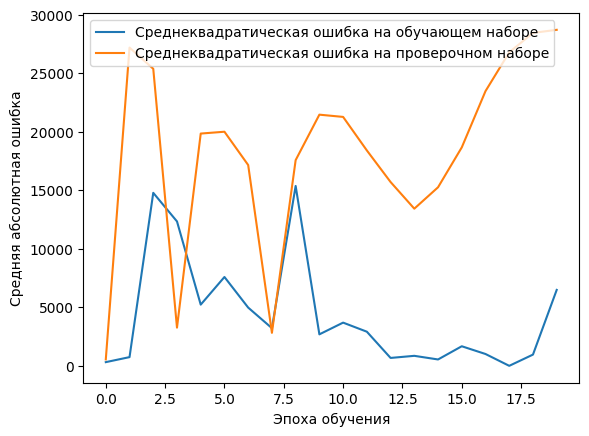

In [ ]:

# Визуализация точности на обучающей выборке
plt.plot(history.history['loss'],
         label='Среднеквадратическая ошибка на обучающем наборе') #mae accuracy
plt.plot(history.history['val_loss'],
        label='Среднеквадратическая ошибка на проверочном наборе') #val_mae val_accuracy
plt.xlabel('Эпоха обучения')
plt.ylabel('Средняя абсолютная ошибка')
plt.legend()
plt.show()

In [ ]:
eval = model.evaluate(x_test, y_test)
print(eval)

1/1 [==============================] - 10s 10s/step - loss: 28731.8984 - accuracy: 0.8750
[28731.8984375, 0.875]


In [ ]:

# Проверка работы сети - предсказание на тренировочной выборке
pred = model.predict(x_train)

# Расчет среднего значения ошибки
print(mean_absolute_error(pred, y_train))

1/1 [==============================] - 0s 32ms/step
0.0
